# Transfer learning for COVID-19 diagnosis using CT images

- This cell is environment dependent. I did the project in Google Colab, so I had to mount my google drive.

- Then, I had to add my drive to valid paths so I could import data_loader.py from my drive to use.

In [ ]:
import sys
from google.colab import drive

drive.mount('/content/drive')

path = '/content/drive/MyDrive'
sys.path.append(path) if path not in sys.path else None

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import warnings

warnings.filterwarnings('ignore', message='torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.')

## Model Creation

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class CovidClassifier(nn.Module):
    def __init__(self, base_model='resnet18', use_pretrained=False):
        super(CovidClassifier, self).__init__()
        # Load the model with proper weights
        if base_model == 'resnet18':
            weights = models.ResNet18_Weights.IMAGENET1K_V1 if use_pretrained else None
            self.base_model = models.resnet18(weights=weights)
        else:
            weights = models.ResNet50_Weights.IMAGENET1K_V1 if use_pretrained else None
            self.base_model = models.resnet50(weights=weights)

        # Custom feature extraction and classification head
        num_features = self.base_model.fc.in_features
        self.base_model.fc = nn.Sequential(
            nn.Linear(num_features, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(512, 2)
        )

    def forward(self, x):
        return self.base_model(x)

## Functions For Model Training and Evaluation

In [ ]:
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report
from torch.optim import Adam
from torch.optim.lr_scheduler import OneCycleLR
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

# Evaluates model's current state based on accuracy and roc-auc
def evaluate_model(model, test_loader):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)

    # Ensure model weights are in float32
    model = model.float()
    model.eval()

    test_preds = []
    test_true = []
    test_probs = []

    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc='Testing'):
            # Ensure inputs are in float32
            images = images.float().to(device)
            labels = labels.squeeze().to(device)

            # No need for autocast in evaluation
            outputs = model(images)
            # Get probabilities using softmax
            probs = torch.softmax(outputs, dim=1)

            # Get predicted class (0 or 1)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            # Get probability of positive class (class 1)
            pos_probs = probs[:, 1].cpu().numpy()

            test_preds.extend(preds)
            test_true.extend(labels.cpu().numpy())
            test_probs.extend(pos_probs)

    # Convert to numpy arrays
    test_preds = np.array(test_preds)
    test_true = np.array(test_true)
    test_probs = np.array(test_probs)

    accuracy = accuracy_score(test_true, test_preds)
    auc_score = roc_auc_score(test_true, test_probs)
    report = classification_report(test_true, test_preds, target_names=['Non-COVID', 'COVID'])

    return accuracy, auc_score, report

**Important Note**

Part of this function saves the best model from the epochs to your file system as `best_model.pth`

Ensure that the model is being saved to the correct destination in your personal file system. It **will be needed** to reload the model at a later point.

This is not necessarry, but it could save time if you are working on a model for multiple sessions and want to ensure it is not lost.


In [ ]:
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import OneCycleLR
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt

def train_model(model, train_loader, val_loader, num_epochs=15):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    model = model.to(device)

    scaler = torch.amp.GradScaler()
    criterion = nn.CrossEntropyLoss()

    # Optimized learning rates for transfer learning
    optimizer = Adam([
        {'params': [p for n, p in model.named_parameters() if 'fc' not in n], 'lr': 1e-4},
        {'params': model.base_model.fc.parameters(), 'lr': 1e-3}
    ])

    # One Cycle learning rate scheduler
    scheduler = OneCycleLR(
        optimizer,
        max_lr=[1e-4, 1e-3],
        steps_per_epoch=len(train_loader),
        epochs=num_epochs,
        pct_start=0.3,
        div_factor=25.0,
        final_div_factor=1e4
    )

    best_val_acc = 0
    best_val_auc = 0
    history = {'train_loss': [], 'val_loss': [], 'train_acc': [], 'val_acc': [],
              'val_auc': [], 'learning_rates': []}

    for epoch in range(num_epochs):
        print(f'\nEpoch {epoch+1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        print(f'Current learning rate: {current_lr:.2e}')

        # Training phase
        model.train()
        train_losses = []
        train_preds = []
        train_true = []

        for images, labels in tqdm(train_loader, desc='Training'):
            images = images.to(device)
            labels = labels.squeeze().long().to(device)  # Convert to long tensor for CrossEntropyLoss

            optimizer.zero_grad()

            with torch.amp.autocast(str(device.type)):
                outputs = model(images)
                loss = criterion(outputs, labels)

            scaler.scale(loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            scheduler.step()
            scaler.step(optimizer)
            scaler.update()

            train_losses.append(loss.item())
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            train_preds.extend(preds)
            train_true.extend(labels.cpu().numpy())

        train_loss = np.mean(train_losses)
        train_acc = accuracy_score(train_true, train_preds)

        # Validation phase
        model.eval()
        val_losses = []
        val_preds = []
        val_true = []
        val_probs = []

        with torch.no_grad():
            for images, labels in val_loader:
                images = images.to(device)
                labels = labels.squeeze().long().to(device)

                with torch.amp.autocast(str(device.type)):
                    outputs = model(images)
                    loss = criterion(outputs, labels)

                val_losses.append(loss.item())
                probs = torch.softmax(outputs, dim=1)[:, 1].cpu().numpy()  # Probability of positive class
                preds = (probs > 0.5).astype(int)
                val_preds.extend(preds)
                val_true.extend(labels.cpu().numpy())
                val_probs.extend(probs)

        val_loss = np.mean(val_losses)
        val_acc = accuracy_score(val_true, val_preds)
        val_auc = roc_auc_score(val_true, val_probs)

        # Save best model
        if val_acc > best_val_acc or (val_acc == best_val_acc and val_auc > best_val_auc):
            best_val_acc = val_acc
            best_val_auc = val_auc
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'scheduler_state_dict': scheduler.state_dict(),
                'val_acc': val_acc,
                'val_auc': val_auc
            }, '/content/drive/MyDrive/best_model.pth')

        # Update history
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['val_auc'].append(val_auc)
        history['learning_rates'].append(current_lr)

        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}')
        print(f'Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.4f} | Val AUC: {val_auc:.4f}')

        if epoch != 0 and epoch % 5 == 0:
            plot_training_history(history)
            plt.show()

    return history

In [ ]:
# Plot current training progress of model
def plot_training_history(history):
    plt.figure(figsize=(20, 5))

    plt.subplot(1, 4, 1)
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['val_loss'], label='Val Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 4, 2)
    plt.plot(history['train_acc'], label='Train Acc')
    plt.plot(history['val_acc'], label='Val Acc')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.subplot(1, 4, 3)
    plt.plot(history['val_auc'], label='Val AUC')
    plt.title('Validation AUC-ROC')
    plt.xlabel('Epoch')
    plt.ylabel('AUC')
    plt.legend()

    plt.subplot(1, 4, 4)
    plt.plot(history['learning_rates'], label='LR')
    plt.title('Learning Rate')
    plt.xlabel('Epoch')
    plt.ylabel('Learning Rate')
    plt.yscale('log')
    plt.legend()

    plt.tight_layout()

## Nerual Network Trained From Scratch



### Training

In [ ]:
from data_loader import get_dataloader

# Load data
train_loader, val_loader, test_loader = get_dataloader(path='/content/drive/MyDrive/S224/')

Using device: cuda

Epoch 1/15
Current learning rate: 4.00e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:224: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


Train Loss: 0.5804 | Train Acc: 0.6780
Val Loss: 0.8580 | Val Acc: 0.5667 | Val AUC: 0.6894

Epoch 2/15
Current learning rate: 1.53e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.3584 | Train Acc: 0.8670
Val Loss: 3.0248 | Val Acc: 0.5500 | Val AUC: 0.7300

Epoch 3/15
Current learning rate: 4.39e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.1849 | Train Acc: 0.9318
Val Loss: 2.0880 | Val Acc: 0.6667 | Val AUC: 0.8300

Epoch 4/15
Current learning rate: 7.63e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.1481 | Train Acc: 0.9466
Val Loss: 4.8657 | Val Acc: 0.5500 | Val AUC: 0.8544

Epoch 5/15
Current learning rate: 9.73e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.1615 | Train Acc: 0.9362
Val Loss: 1.5485 | Val Acc: 0.7000 | Val AUC: 0.8211

Epoch 6/15
Current learning rate: 9.94e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0880 | Train Acc: 0.9669
Val Loss: 1.4511 | Val Acc: 0.6833 | Val AUC: 0.7944


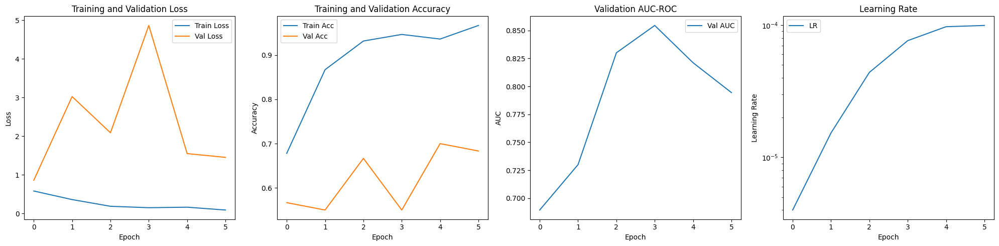


Epoch 7/15
Current learning rate: 9.49e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0994 | Train Acc: 0.9713
Val Loss: 0.7155 | Val Acc: 0.8167 | Val AUC: 0.9533

Epoch 8/15
Current learning rate: 8.65e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0615 | Train Acc: 0.9842
Val Loss: 1.6355 | Val Acc: 0.7167 | Val AUC: 0.9322

Epoch 9/15
Current learning rate: 7.48e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0604 | Train Acc: 0.9812
Val Loss: 1.1046 | Val Acc: 0.8500 | Val AUC: 0.9350

Epoch 10/15
Current learning rate: 6.09e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0246 | Train Acc: 0.9921
Val Loss: 2.6891 | Val Acc: 0.6167 | Val AUC: 0.8500

Epoch 11/15
Current learning rate: 4.60e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0212 | Train Acc: 0.9960
Val Loss: 1.2233 | Val Acc: 0.8167 | Val AUC: 0.9200


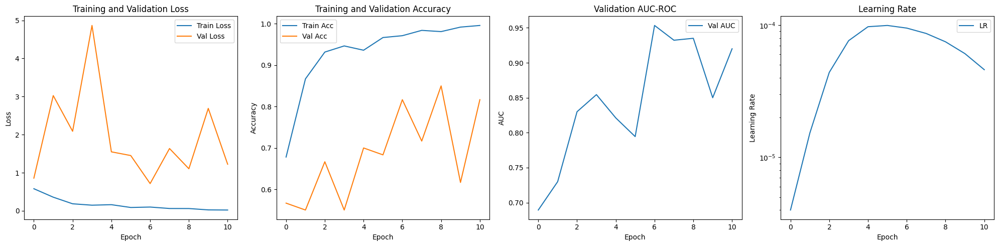


Epoch 12/15
Current learning rate: 3.15e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0033 | Train Acc: 0.9985
Val Loss: 0.7616 | Val Acc: 0.9333 | Val AUC: 0.9383

Epoch 13/15
Current learning rate: 1.86e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0013 | Train Acc: 0.9995
Val Loss: 0.7071 | Val Acc: 0.9000 | Val AUC: 0.9478

Epoch 14/15
Current learning rate: 8.56e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0101 | Train Acc: 0.9995
Val Loss: 0.7325 | Val Acc: 0.9000 | Val AUC: 0.9467

Epoch 15/15
Current learning rate: 2.15e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0009 | Train Acc: 0.9995
Val Loss: 0.7507 | Val Acc: 0.9167 | Val AUC: 0.9494


In [ ]:
# Train model from scratch
model_scratch = CovidClassifier(use_pretrained=False)
history_scratch = train_model(model_scratch, train_loader, val_loader)

### Saving & Reloading Best Model

This process depends on your local machine and runtime environment. Specify the path as needed to ensure this functions correctly.

In [ ]:
import os
# best_mode.pth gets overwritten each time train_model is called, move model to permanent destination
os.rename('/content/drive/MyDrive/best_model.pth', '/content/drive/MyDrive/best_model_scratch.pth')

In [ ]:
# Load Best Preforming model
best_model_scratch = CovidClassifier(use_pretrained=False)
checkpoint = torch.load('/content/drive/MyDrive/best_model_scratch.pth')
best_model_scratch.load_state_dict(checkpoint['model_state_dict'])

<ipython-input-10-14e496c1460b>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('/content/drive/MyDrive/best_model_scratch.pth')


<All keys matched successfully>

### Analyzing Preformance

In [ ]:
# Evaluate scratch model
accuracy_scratch, auc_scratch, report_scratch = evaluate_model(best_model_scratch, test_loader)
print("\nModel trained from scratch:")
print(f"Test Accuracy: {accuracy_scratch:.4f}")
print("Classification Report:")
print(report_scratch)

Testing:   0%|          | 0/13 [00:00<?, ?it/s]


Model trained from scratch:
Test Accuracy: 0.9225
Classification Report:
              precision    recall  f1-score   support

   Non-COVID       0.95      0.89      0.92       200
       COVID       0.90      0.95      0.92       200

    accuracy                           0.92       400
   macro avg       0.92      0.92      0.92       400
weighted avg       0.92      0.92      0.92       400



## Neural Network Using Transfer Learning

### Training

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 173MB/s]


Using device: cuda

Epoch 1/15
Current learning rate: 4.00e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:224: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


Train Loss: 0.4544 | Train Acc: 0.7760
Val Loss: 0.6314 | Val Acc: 0.7667 | Val AUC: 0.9011

Epoch 2/15
Current learning rate: 1.53e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.1398 | Train Acc: 0.9481
Val Loss: 0.1105 | Val Acc: 0.9833 | Val AUC: 0.9933

Epoch 3/15
Current learning rate: 4.39e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0294 | Train Acc: 0.9916
Val Loss: 0.3976 | Val Acc: 0.9167 | Val AUC: 0.9628

Epoch 4/15
Current learning rate: 7.63e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0369 | Train Acc: 0.9862
Val Loss: 0.2055 | Val Acc: 0.9500 | Val AUC: 0.9922

Epoch 5/15
Current learning rate: 9.73e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0530 | Train Acc: 0.9847
Val Loss: 0.3009 | Val Acc: 0.9500 | Val AUC: 0.9722

Epoch 6/15
Current learning rate: 9.94e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.1881 | Train Acc: 0.9758
Val Loss: 0.4037 | Val Acc: 0.9167 | Val AUC: 0.9706


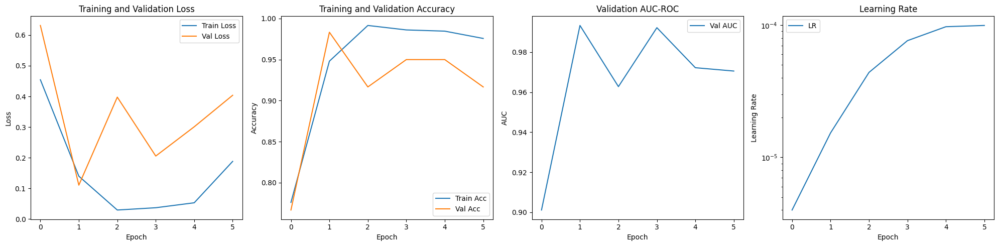


Epoch 7/15
Current learning rate: 9.49e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0292 | Train Acc: 0.9896
Val Loss: 0.1394 | Val Acc: 0.9833 | Val AUC: 0.9811

Epoch 8/15
Current learning rate: 8.65e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0152 | Train Acc: 0.9951
Val Loss: 0.1627 | Val Acc: 0.9833 | Val AUC: 0.9817

Epoch 9/15
Current learning rate: 7.48e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0242 | Train Acc: 0.9941
Val Loss: 0.1692 | Val Acc: 0.9667 | Val AUC: 0.9800

Epoch 10/15
Current learning rate: 6.09e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0051 | Train Acc: 0.9975
Val Loss: 0.2292 | Val Acc: 0.9667 | Val AUC: 0.9828

Epoch 11/15
Current learning rate: 4.60e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0029 | Train Acc: 0.9990
Val Loss: 0.1599 | Val Acc: 0.9833 | Val AUC: 0.9833


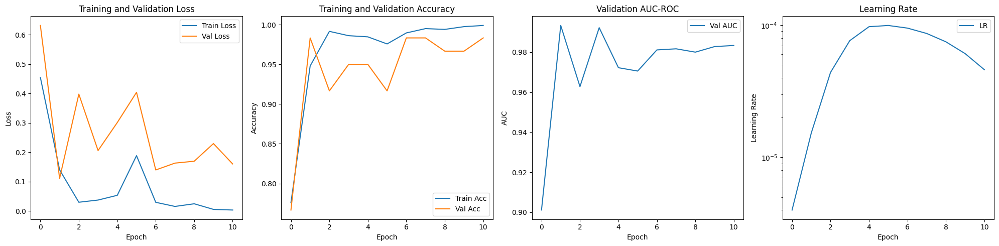


Epoch 12/15
Current learning rate: 3.15e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0055 | Train Acc: 0.9975
Val Loss: 0.1735 | Val Acc: 0.9833 | Val AUC: 0.9828

Epoch 13/15
Current learning rate: 1.86e-05


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0021 | Train Acc: 0.9995
Val Loss: 0.1657 | Val Acc: 0.9833 | Val AUC: 0.9828

Epoch 14/15
Current learning rate: 8.56e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0002 | Train Acc: 1.0000
Val Loss: 0.1777 | Val Acc: 0.9833 | Val AUC: 0.9833

Epoch 15/15
Current learning rate: 2.15e-06


Training:   0%|          | 0/64 [00:00<?, ?it/s]

Train Loss: 0.0031 | Train Acc: 0.9985
Val Loss: 0.1835 | Val Acc: 0.9833 | Val AUC: 0.9833


In [ ]:
# 2. Training with transfer learning
model_transfer = CovidClassifier(use_pretrained=True,)
history_transfer = train_model(model_transfer, train_loader, val_loader)

### Saving & Reloading Best Model

This process depends on your local machine and runtime environment. Specify the path as needed to ensure this functions correctly.

In [ ]:
os.rename('/content/drive/MyDrive/best_model.pth', '/content/drive/MyDrive/best_model_transfer.pth')

In [ ]:
best_model_transfer = CovidClassifier(use_pretrained=True)
checkpoint = torch.load('/content/drive/MyDrive/best_model_transfer.pth')
best_model_transfer.load_state_dict(checkpoint['model_state_dict'])

<ipython-input-14-0742abe58d37>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('/content/drive/MyDrive/best_model_transfer.pth')


<All keys matched successfully>

### Preformance Analysis

In [ ]:
accuracy_transfer, auc_transfer, report_transfer = evaluate_model(best_model_transfer, test_loader)
print("\nModel trained with transfer learning:")
print(f"Test Accuracy: {accuracy_transfer:.4f}")
print("Classification Report:")
print(report_transfer)

Testing:   0%|          | 0/13 [00:00<?, ?it/s]


Model trained with transfer learning:
Test Accuracy: 0.9600
Classification Report:
              precision    recall  f1-score   support

   Non-COVID       0.95      0.97      0.96       200
       COVID       0.97      0.95      0.96       200

    accuracy                           0.96       400
   macro avg       0.96      0.96      0.96       400
weighted avg       0.96      0.96      0.96       400



## Analysis Using Comprehensive Visualizations

Colab didn't have this installed.

In [ ]:
# Run this cell to install
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 79.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.4-py3-none-any.whl size=39588 sha256=cfe5e59da8a115215cde268e4c0dcb22a33b8d16a0e07ed75d9a8fc12e9e08d7
  Stored in directory: /root/.cache/pip/wheels/50/b0/82/1f97b5348c7fe9f0ce0ba18497202cafa5dec4562bd5292680
Successfully built grad-cam


These are functions that will be utilized by both visualization techniques

In [ ]:
import skimage
import pandas as pd
import numpy as np
import random

def get_random_samples(num_samples=10):
    """
    Get random samples from test set, balanced between COVID and non-COVID.

    Args:
        num_samples: Total number of samples to select (half COVID, half non-COVID)
    Returns:
        List of selected filenames
    """
    # Read test.csv to get filenames
    df = pd.read_csv('/content/drive/MyDrive/S224/test.csv')

    # Get equal numbers of COVID and non-COVID samples
    samples_per_class = num_samples // 2
    covid_samples = random.sample(list(df[df['label'] == 1]['filename'].values), samples_per_class)
    non_covid_samples = random.sample(list(df[df['label'] == 0]['filename'].values), samples_per_class)

    # Combine samples
    selected_samples = covid_samples + non_covid_samples
    random.shuffle(selected_samples)  # Shuffle to mix classes

    return selected_samples

def prepare_image_for_display(image_tensor):
    """Convert tensor to numpy array in correct format for display."""
    # Convert to numpy and transpose from (C,H,W) to (H,W,C)
    image_np = image_tensor.cpu().numpy()
    image_np = np.transpose(image_np, (1, 2, 0))

    # If grayscale (image was expanded to 3 identical channels)
    if np.allclose(image_np[:,:,0], image_np[:,:,1]) and np.allclose(image_np[:,:,1], image_np[:,:,2]):
        image_np = image_np[:,:,0]

    # Normalize to [0,1] range
    image_np = (image_np - image_np.min()) / (image_np.max() - image_np.min())

    return image_np

def analyze_results(results_df):
    """
    Analyze and print detailed results from the visualizations.

    Args:
        results_df: DataFrame containing visualization results
    """
    print("\nDetailed Analysis:")

    # Class-wise performance
    print("\nClass-wise Performance:")
    for label in [0, 1]:
        class_results = results_df[results_df['true_label'] == label]
        correct = class_results['correct'].sum()
        total = len(class_results)
        class_name = "COVID" if label == 1 else "Non-COVID"
        print(f"{class_name}:")
        print(f"  Accuracy: {correct}/{total} ({100*correct/total:.1f}%)")
        print(f"  Average Confidence: {class_results['confidence'].mean():.1f}%")

    # Confidence analysis
    print("\nConfidence Analysis:")
    print(f"Average confidence (correct predictions): {results_df[results_df['correct']]['confidence'].mean():.1f}%")
    print(f"Average confidence (incorrect predictions): {results_df[~results_df['correct']]['confidence'].mean():.1f}%")

# Get a set of random samples that will be used for all visualizations
selected_samples = get_random_samples(num_samples=20)  # 10 COVID, 10 non-COVID
selected_samples

['COVID/Covid (1151).png',
 'COVID/Covid (957).png',
 'COVID/Covid (388).png',
 'COVID/Covid (524).png',
 'NORMAL/Non-Covid (1132).png',
 'NORMAL/Non-Covid (330).png',
 'NORMAL/Non-Covid (395).png',
 'NORMAL/Non-Covid (153).png',
 'COVID/Covid (944).png',
 'COVID/Covid (579).png',
 'NORMAL/Non-Covid (945).png',
 'NORMAL/Non-Covid (622).png',
 'NORMAL/Non-Covid (1148).png',
 'COVID/Covid (672).png',
 'NORMAL/Non-Covid (375).png',
 'COVID/Covid (649).png',
 'COVID/Covid (36).png',
 'COVID/Covid (32).png',
 'NORMAL/Non-Covid (71).png',
 'NORMAL/Non-Covid (522).png']

### GradCAM

#### Core Code

In [ ]:
import torch
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def visualize_single_gradcam(model, image, label, save_path=None, temperature=4.0):
    """
    Generate and display GradCAM visualization for a single image with confidence scores.

    Args:
        model: The trained model
        image: Input image as tensor (should be in shape [C,H,W])
        label: True label (0 for Non-COVID, 1 for COVID)
        save_path: Optional path to save the visualization
        temperature: Scaling factor for logits (higher = softer predictions)
    """
    # Setup
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    model.eval()

    # Get the target layer
    target_layer = model.base_model.layer4[-1]

    # Initialize GradCAM
    cam = GradCAM(model=model, target_layers=[target_layer])

    # Prepare image and get model prediction
    input_tensor = image.unsqueeze(0).float().to(device)

    with torch.no_grad():
        # Get raw logits
        outputs = model(input_tensor)

        # Apply temperature scaling to logits before softmax
        scaled_outputs = outputs / temperature

        # Calculate probabilities
        probs = F.softmax(scaled_outputs, dim=1)
        pred = torch.argmax(outputs, dim=1).item()

        # Get probabilities for both classes
        prob_negative = probs[0][0].item() * 100
        prob_positive = probs[0][1].item() * 100

        # Get confidence for predicted class
        confidence = probs[0][pred].item() * 100

    # Generate GradCAM
    grayscale_cam = cam(input_tensor=input_tensor)
    grayscale_cam = grayscale_cam[0]

    # Create visualization
    plt.figure(figsize=(15, 5))

    # Plot original image
    orig_img = prepare_image_for_display(image)
    plt.subplot(1, 3, 1)
    plt.imshow(orig_img, cmap='gray')
    plt.title(f'True Label: {"COVID" if label == 1 else "Non-COVID"}\nPrediction: {"COVID" if pred == 1 else "Non-COVID"} ({confidence:.1f}%)')
    plt.axis('off')

    # Plot heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(grayscale_cam, cmap='jet')
    plt.title('GradCAM Heatmap')
    plt.axis('off')

    # Plot overlay
    plt.subplot(1, 3, 3)
    if len(orig_img.shape) == 2:
        # Handle grayscale images
        orig_img_normalized = (orig_img - orig_img.min()) / (orig_img.max() - orig_img.min())
        overlay = np.stack([orig_img_normalized] * 3, axis=-1)
    else:
        # Handle RGB images
        overlay = (orig_img - orig_img.min()) / (orig_img.max() - orig_img.min())

    # Create heatmap overlay
    heatmap = plt.cm.jet(grayscale_cam)[:, :, :3]

    # Combine original image and heatmap
    superimposed = (0.6 * overlay + 0.4 * heatmap)
    superimposed = np.clip(superimposed, 0, 1)

    plt.imshow(superimposed)
    plt.title('Overlay')
    plt.axis('off')

    # Finalize and display
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', dpi=300)
    plt.show()

    return pred, confidence, prob_negative, prob_positive

In [ ]:
def visualize_multiple_gradcam(model, selected_samples, temperature=4.0):
    """
    Generate GradCAM visualizations for specified samples using matplotlib.

    Args:
        model: The trained model
        selected_samples: List of filenames to visualize
        temperature: Temperature scaling for confidence
    """
    results = []
    base_path = '/content/drive/MyDrive/S224/'

    for i, filename in enumerate(selected_samples):
        # Load image
        img = skimage.io.imread(base_path + filename)
        img = skimage.util.img_as_float32(img)
        img = img.reshape(1, img.shape[0], img.shape[1])
        img = torch.tensor(img, dtype=torch.float32)
        img = img.expand(3, img.shape[1], img.shape[2])

        # Get true label from filename
        label = 1 if 'COVID' in filename else 0

        print(f"\nProcessing image {i+1}/{len(selected_samples)}: {filename}")

        # Generate visualization
        pred, conf, prob_neg, prob_pos = visualize_single_gradcam(
            model, img, label, temperature=temperature
        )

        # Store results
        results.append({
            'filename': filename,
            'true_label': label,
            'predicted_label': pred,
            'confidence': conf,
            'prob_negative': prob_neg,
            'prob_positive': prob_pos,
            'correct': pred == label,
            'method': 'GradCAM'
        })

    # Print summary
    print("\nGradCAM Summary:")
    print(f"Total samples: {len(selected_samples)}")
    correct = sum(1 for r in results if r['correct'])
    print(f"Correct predictions: {correct}/{len(selected_samples)} ({100*correct/len(selected_samples):.1f}%)")

    # Create DataFrame for easy analysis
    results_df = pd.DataFrame(results)
    return results_df

#### Scratch Model

Generating visualizations for model trained from scratch:

Processing image 1/20: COVID/Covid (1151).png


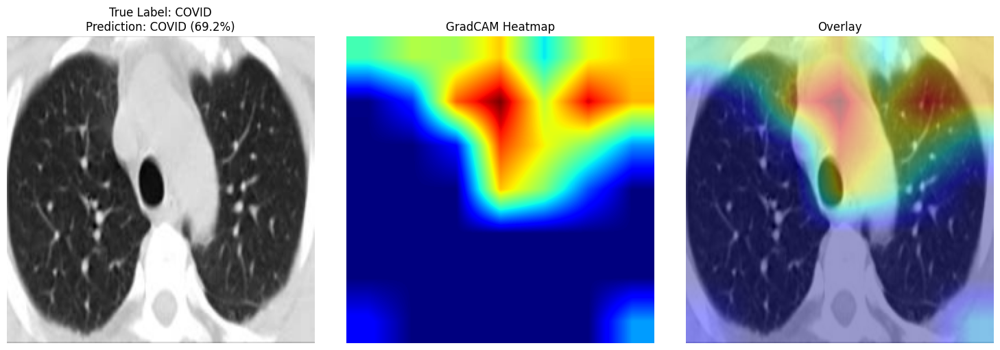


Processing image 2/20: COVID/Covid (957).png


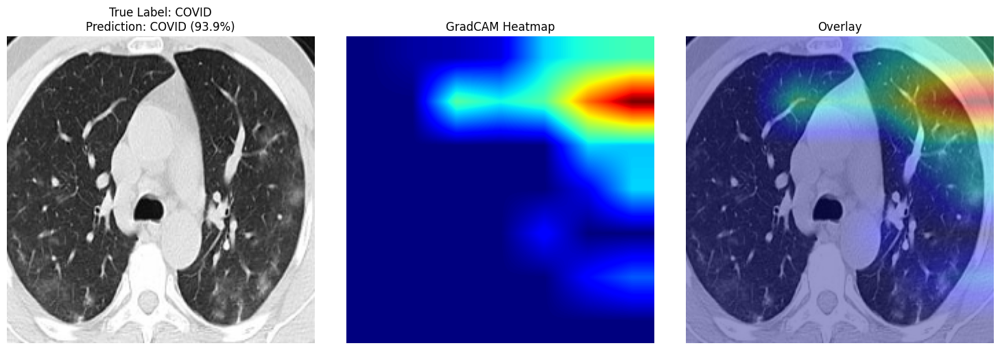


Processing image 3/20: COVID/Covid (388).png


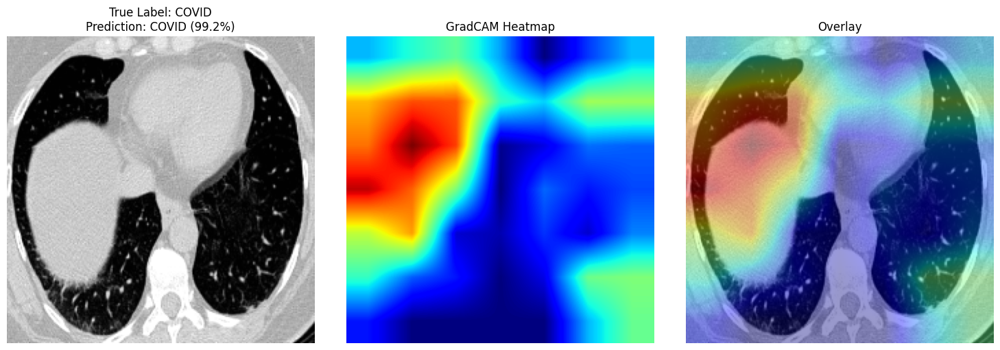


Processing image 4/20: COVID/Covid (524).png


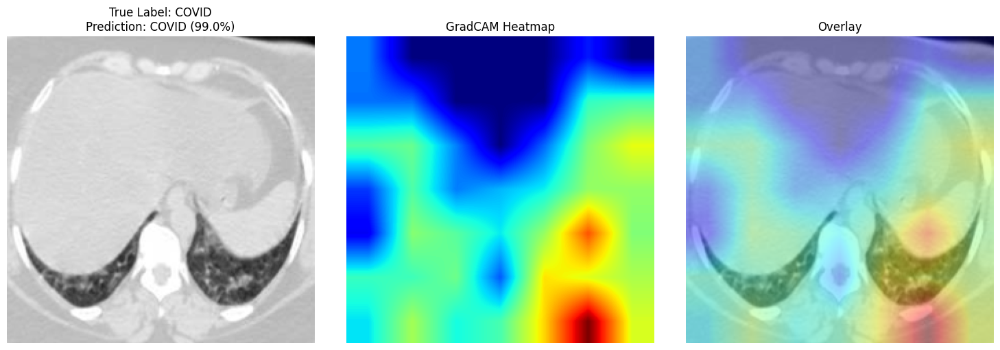


Processing image 5/20: NORMAL/Non-Covid (1132).png


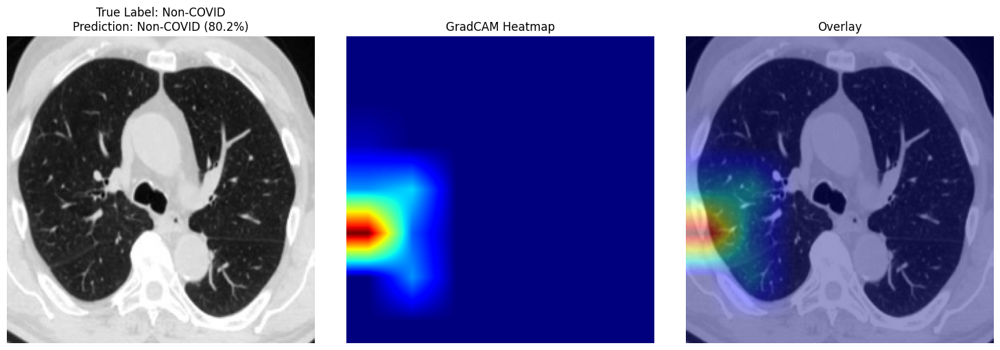


Processing image 6/20: NORMAL/Non-Covid (330).png


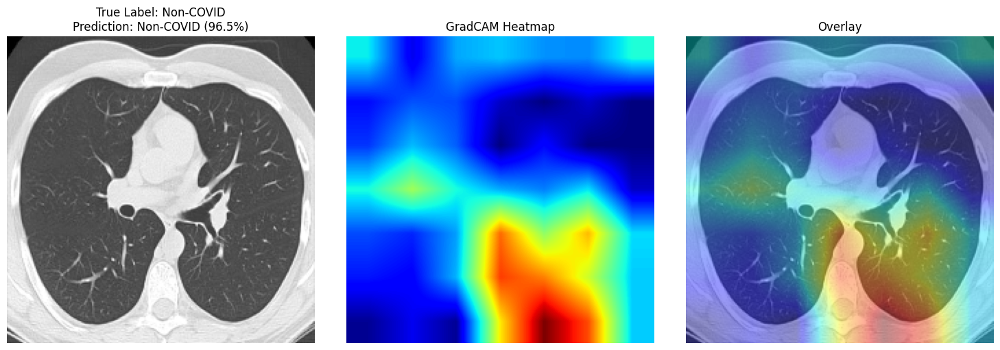


Processing image 7/20: NORMAL/Non-Covid (395).png


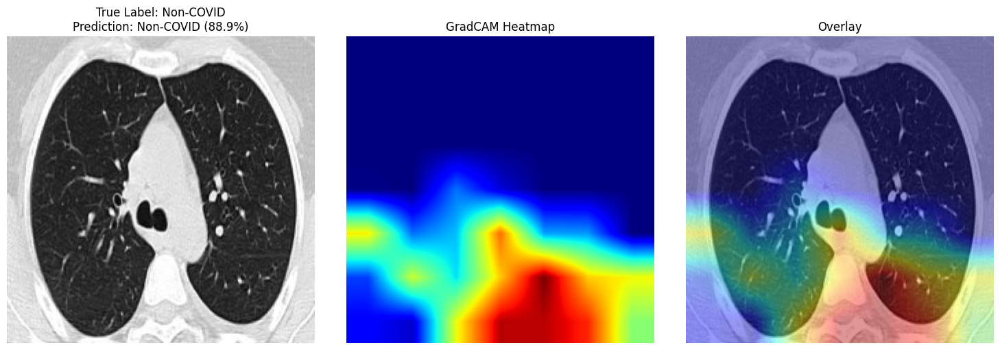


Processing image 8/20: NORMAL/Non-Covid (153).png


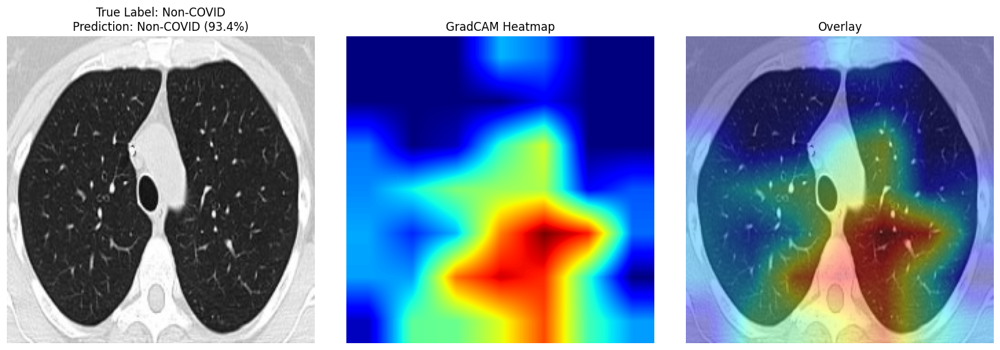


Processing image 9/20: COVID/Covid (944).png


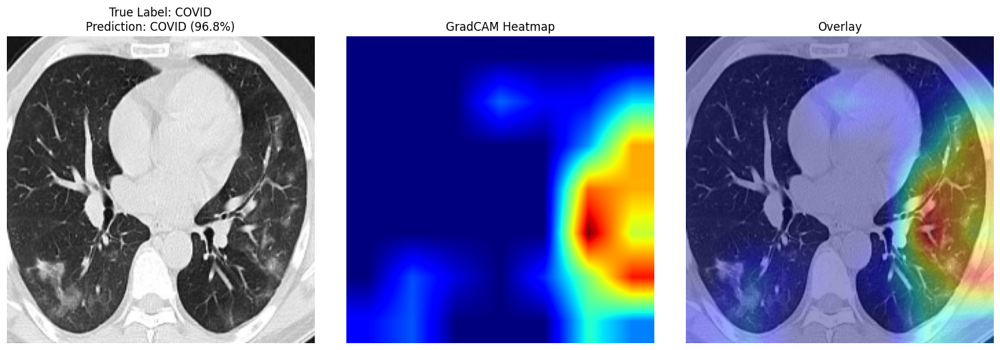


Processing image 10/20: COVID/Covid (579).png


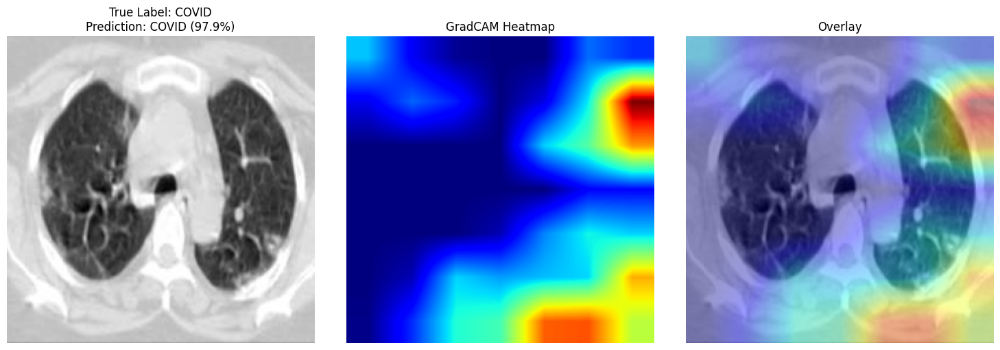


Processing image 11/20: NORMAL/Non-Covid (945).png


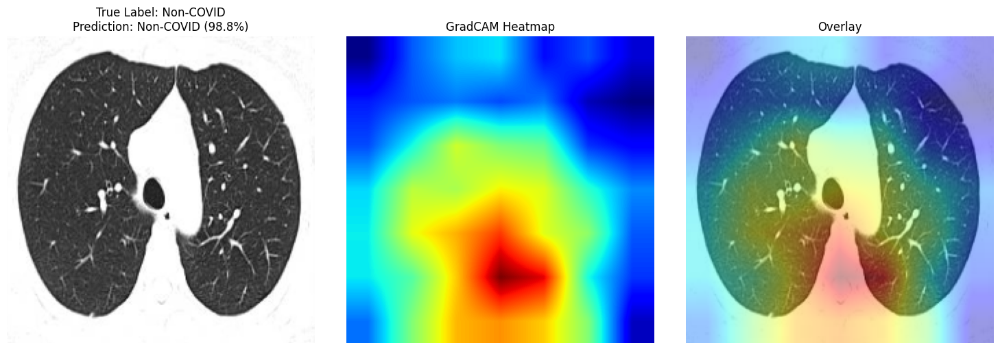


Processing image 12/20: NORMAL/Non-Covid (622).png


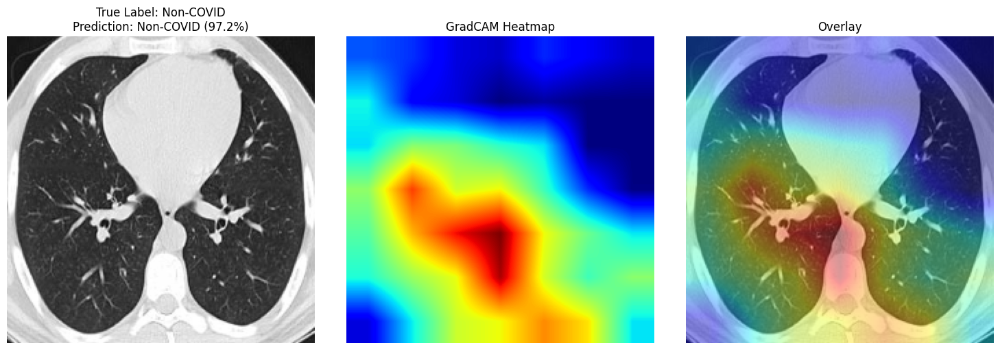


Processing image 13/20: NORMAL/Non-Covid (1148).png


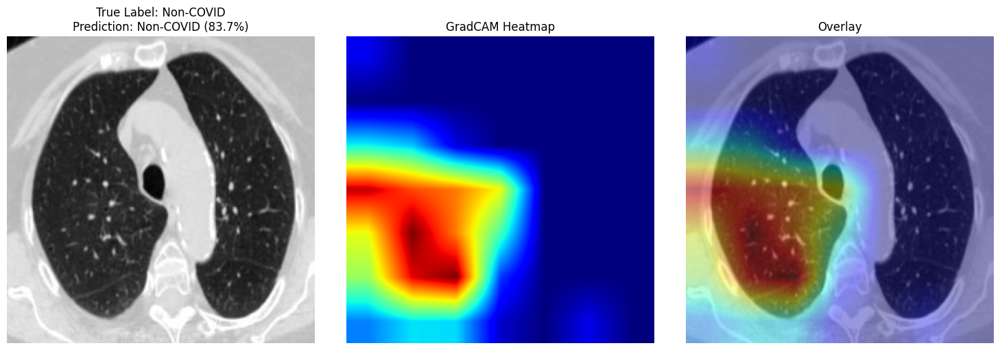


Processing image 14/20: COVID/Covid (672).png


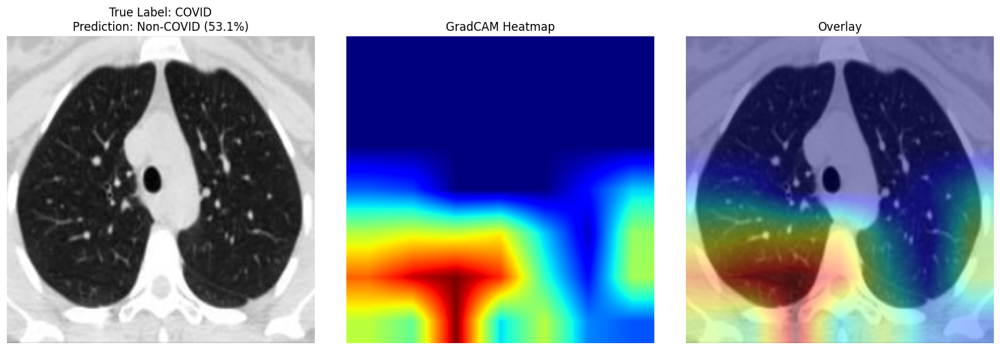


Processing image 15/20: NORMAL/Non-Covid (375).png


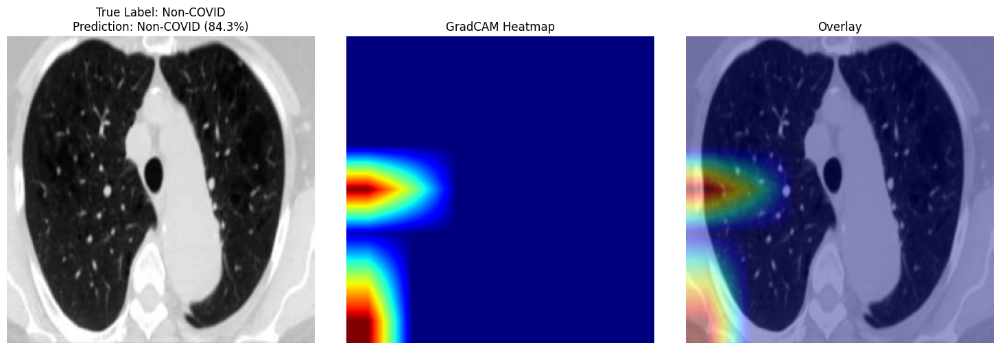


Processing image 16/20: COVID/Covid (649).png


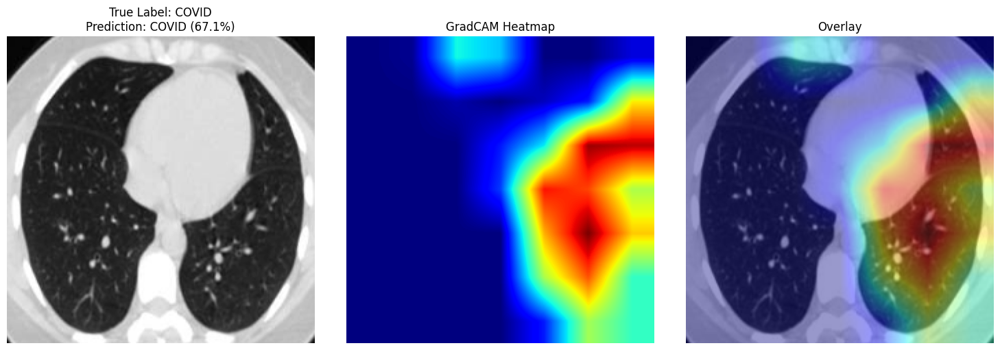


Processing image 17/20: COVID/Covid (36).png


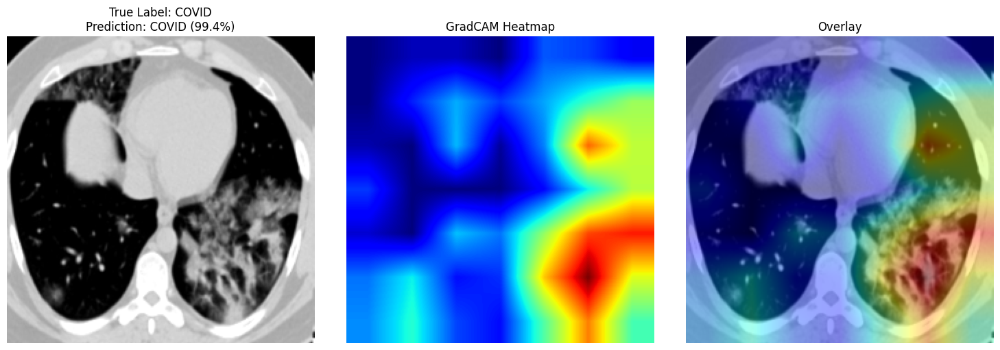


Processing image 18/20: COVID/Covid (32).png


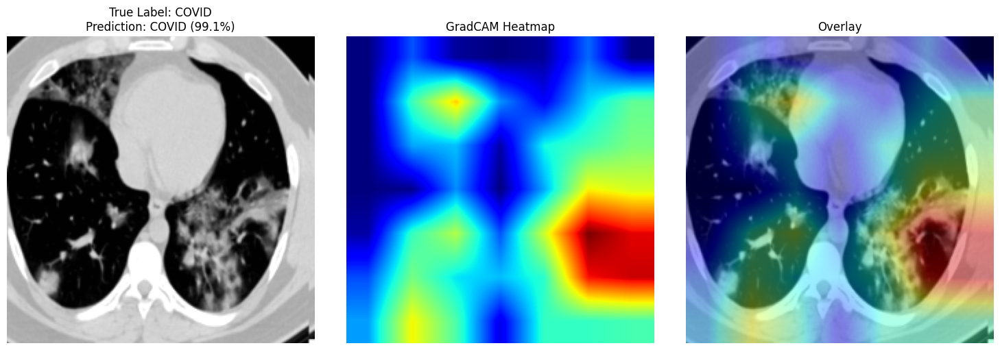


Processing image 19/20: NORMAL/Non-Covid (71).png


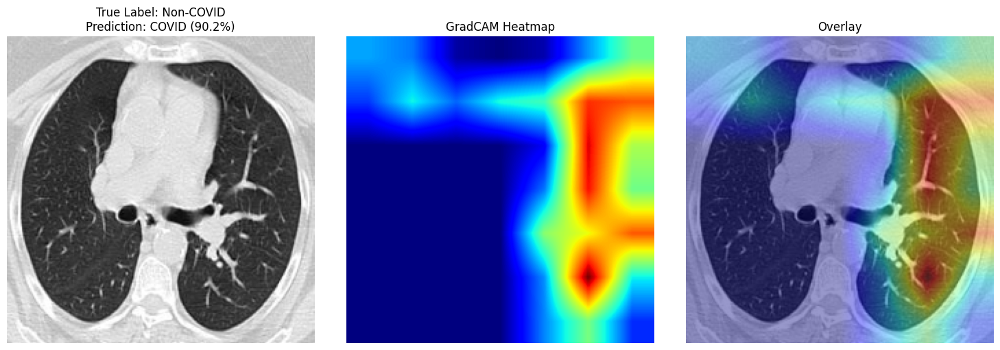


Processing image 20/20: NORMAL/Non-Covid (522).png


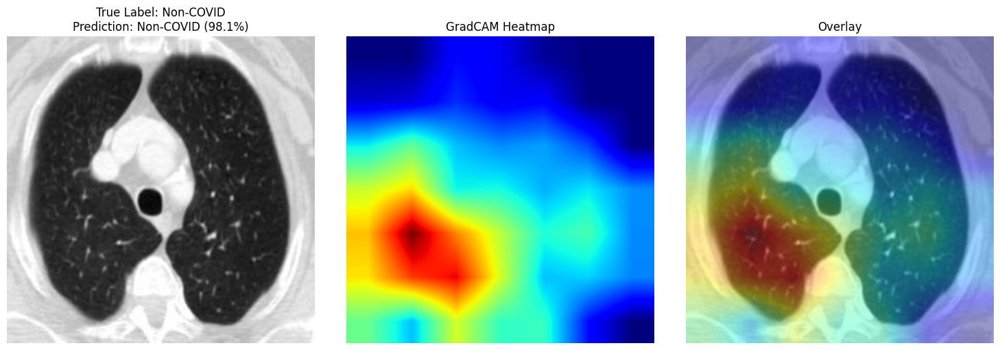


GradCAM Summary:
Total samples: 20
Correct predictions: 18/20 (90.0%)


In [ ]:
# Generate visualizations for scratch model
print("Generating visualizations for model trained from scratch:")
results_scratch = visualize_multiple_gradcam(
    best_model_scratch,
    selected_samples=selected_samples,
    temperature=4.0
)

In [ ]:
analyze_results(results_scratch)


Detailed Analysis:

Class-wise Performance:
Non-COVID:
  Accuracy: 9/10 (90.0%)
  Average Confidence: 91.1%
COVID:
  Accuracy: 9/10 (90.0%)
  Average Confidence: 87.5%

Confidence Analysis:
Average confidence (correct predictions): 91.3%
Average confidence (incorrect predictions): 71.6%


#### Transfer Learning Model


Processing image 1/20: COVID/Covid (1151).png


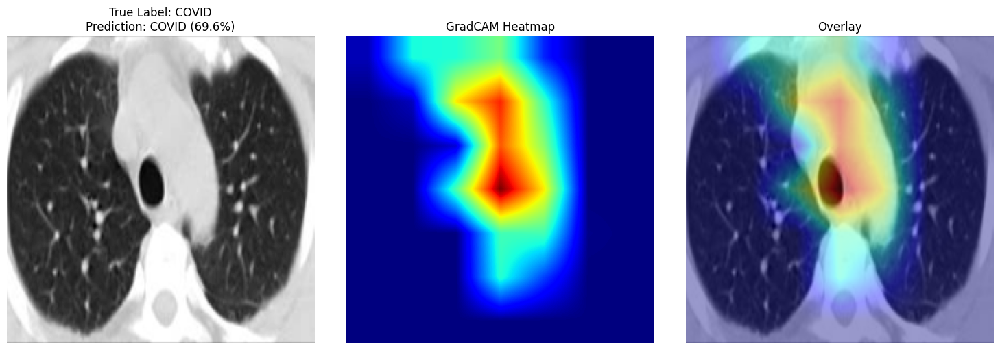


Processing image 2/20: COVID/Covid (957).png


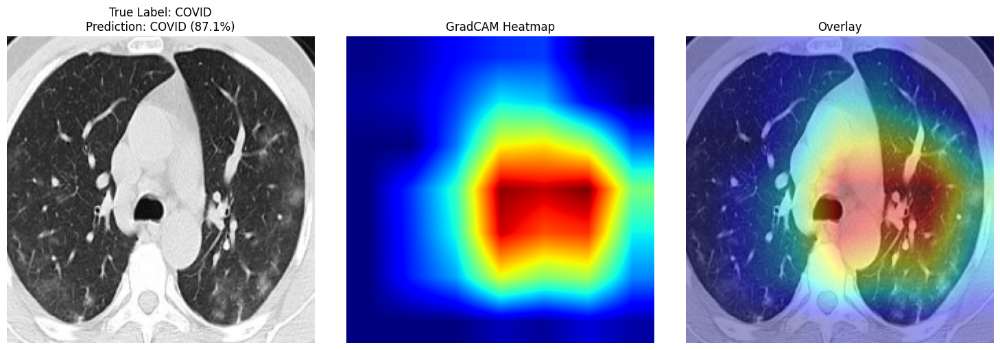


Processing image 3/20: COVID/Covid (388).png


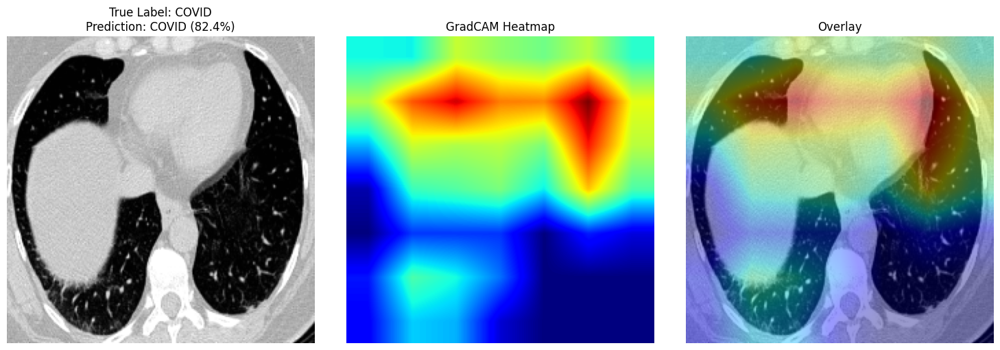


Processing image 4/20: COVID/Covid (524).png


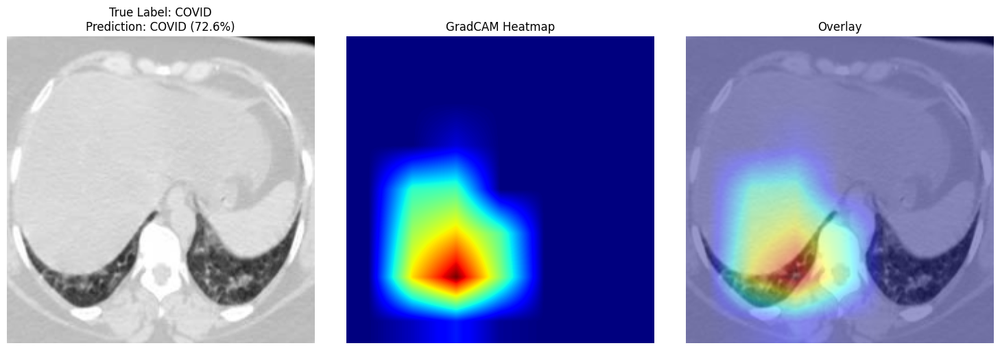


Processing image 5/20: NORMAL/Non-Covid (1132).png


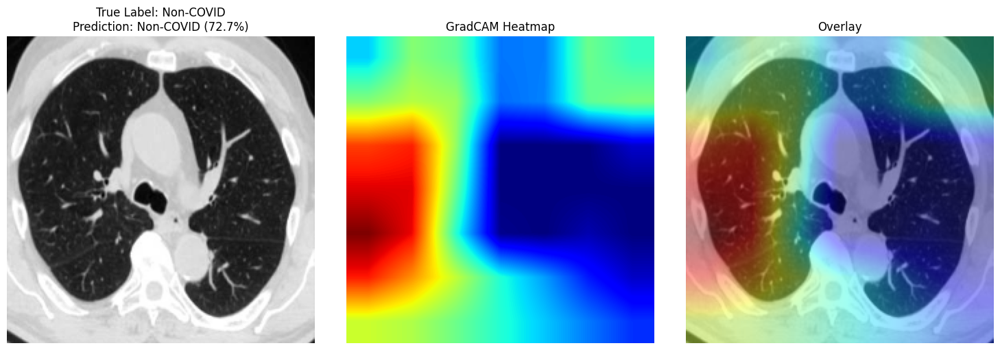


Processing image 6/20: NORMAL/Non-Covid (330).png


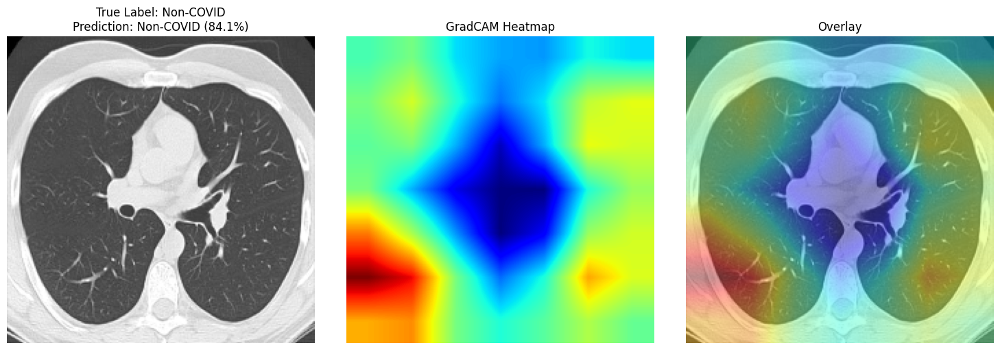


Processing image 7/20: NORMAL/Non-Covid (395).png


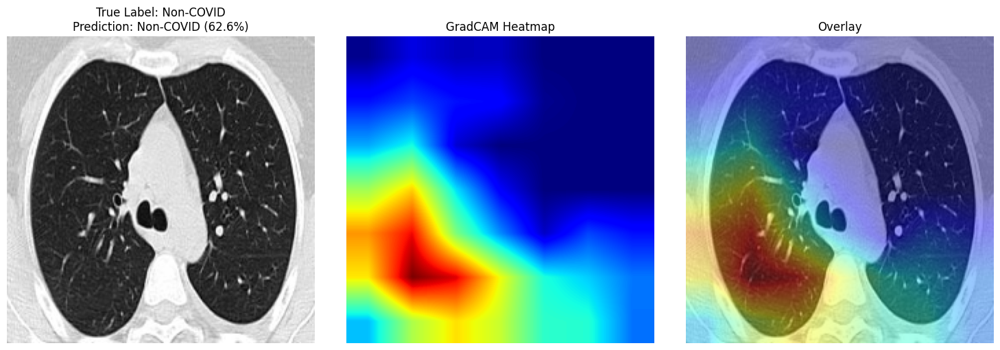


Processing image 8/20: NORMAL/Non-Covid (153).png


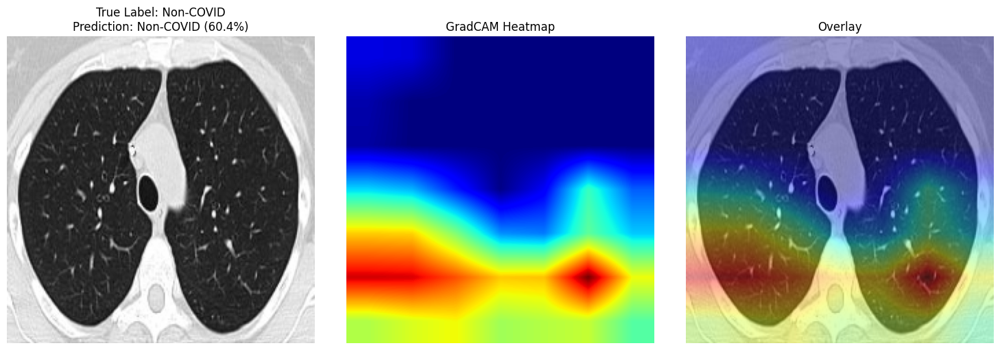


Processing image 9/20: COVID/Covid (944).png


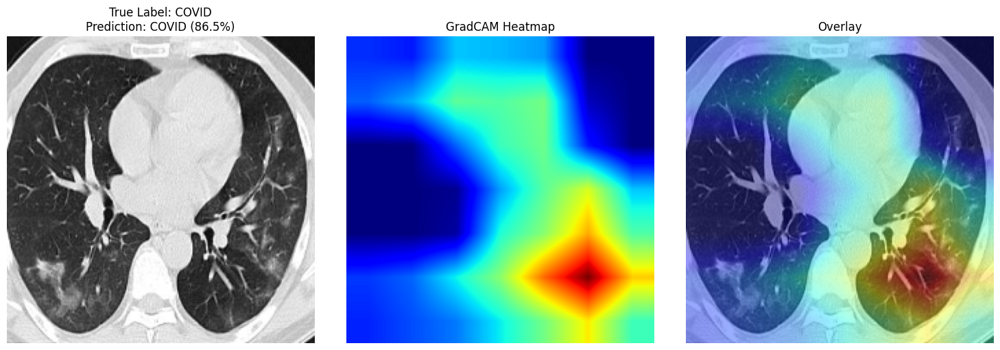


Processing image 10/20: COVID/Covid (579).png


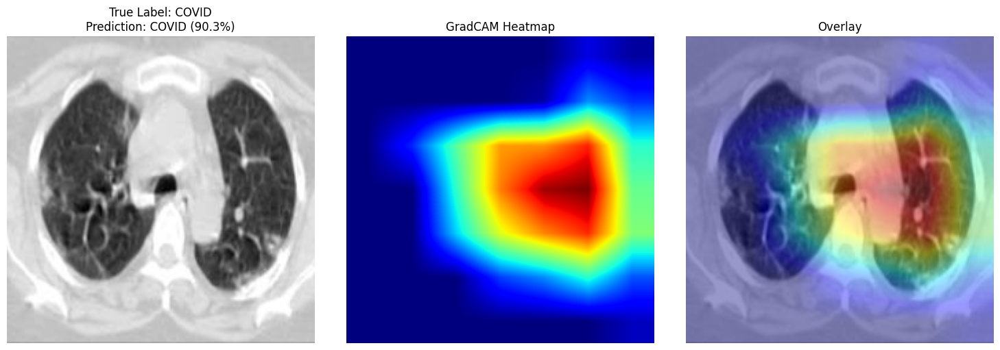


Processing image 11/20: NORMAL/Non-Covid (945).png


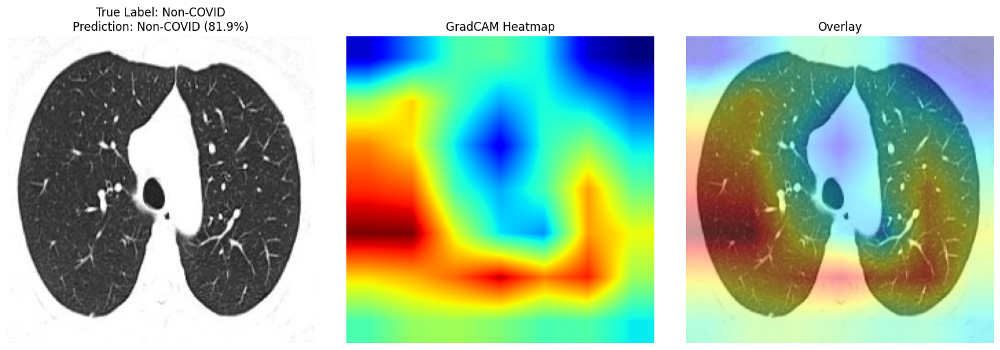


Processing image 12/20: NORMAL/Non-Covid (622).png


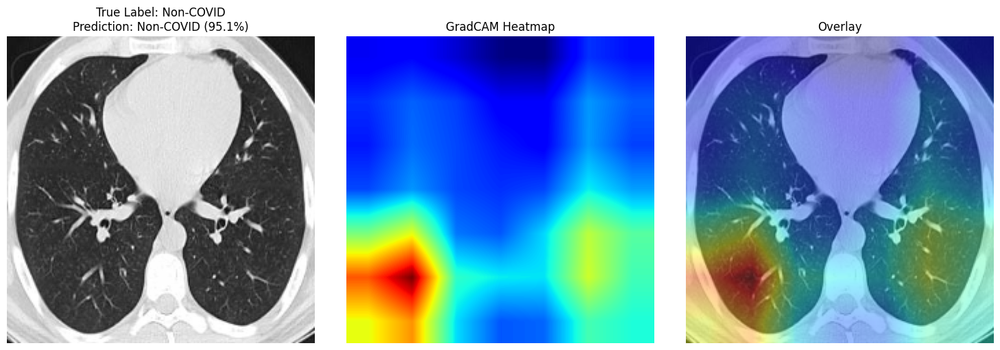


Processing image 13/20: NORMAL/Non-Covid (1148).png


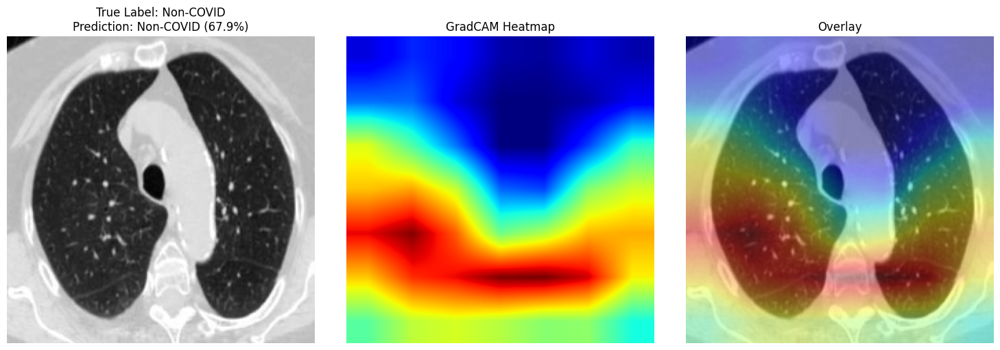


Processing image 14/20: COVID/Covid (672).png


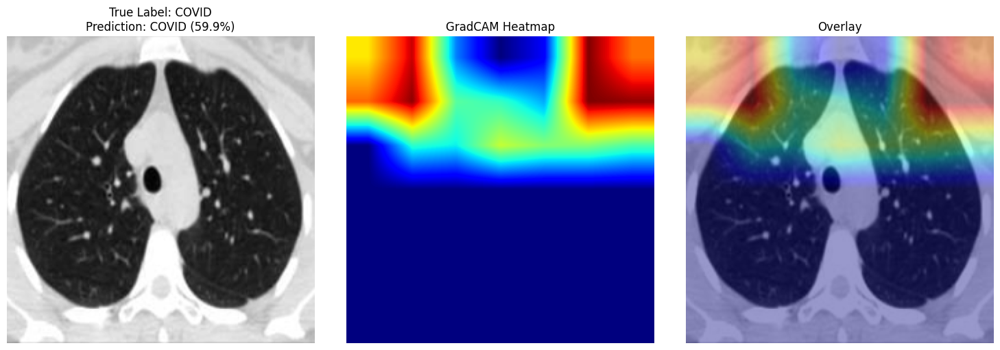


Processing image 15/20: NORMAL/Non-Covid (375).png


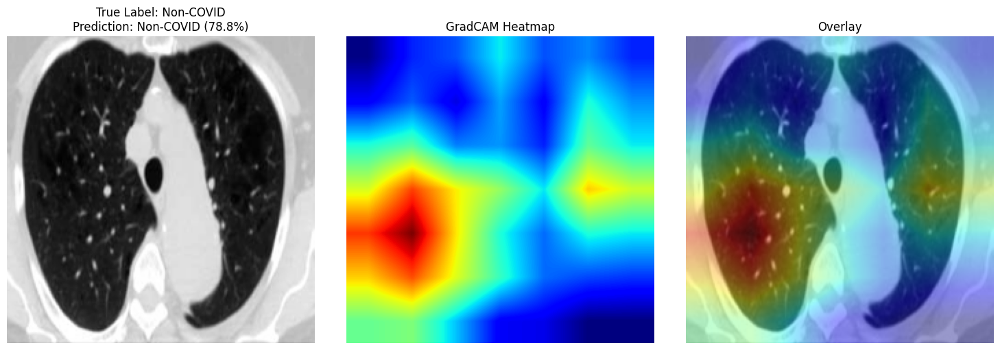


Processing image 16/20: COVID/Covid (649).png


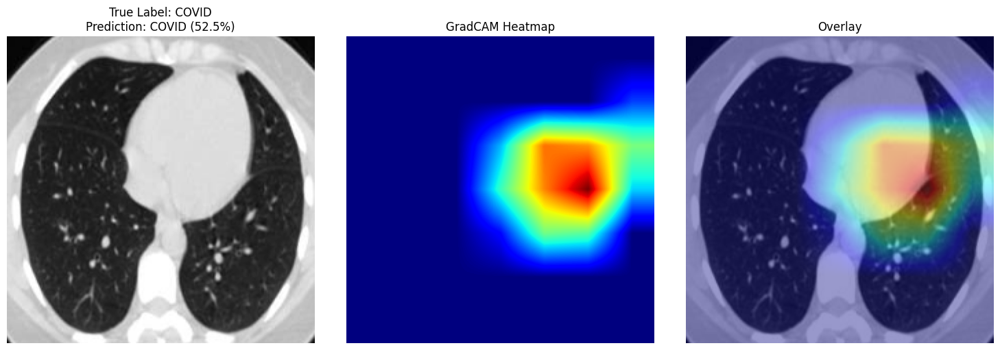


Processing image 17/20: COVID/Covid (36).png


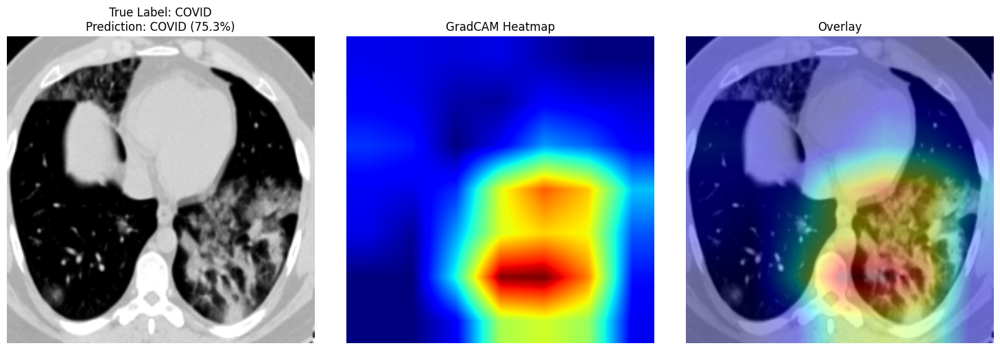


Processing image 18/20: COVID/Covid (32).png


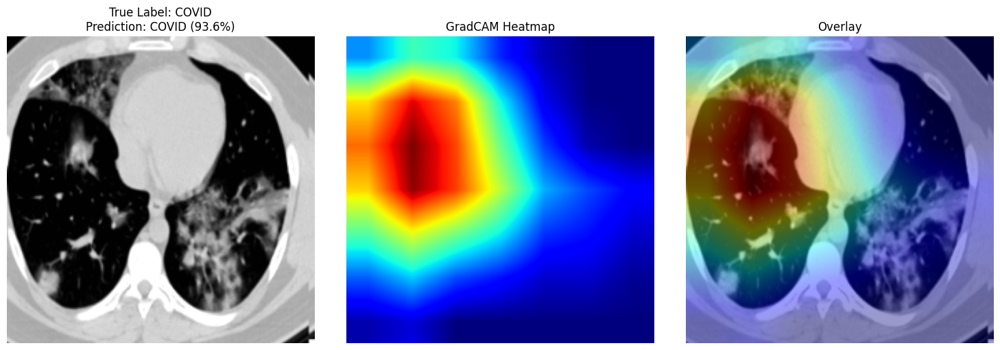


Processing image 19/20: NORMAL/Non-Covid (71).png


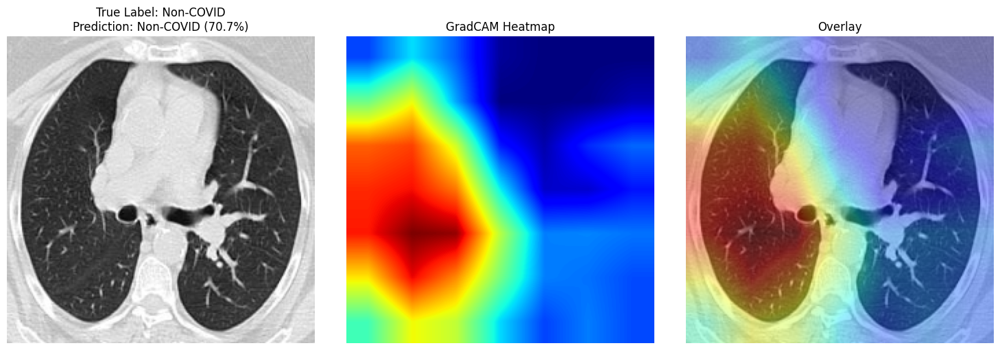


Processing image 20/20: NORMAL/Non-Covid (522).png


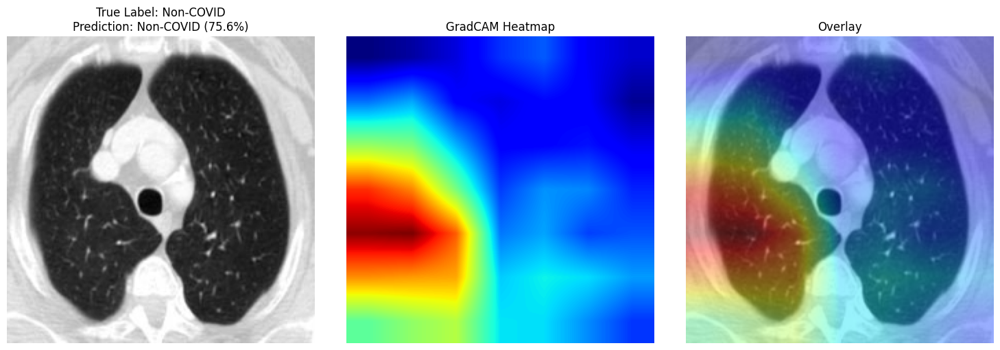


GradCAM Summary:
Total samples: 20
Correct predictions: 20/20 (100.0%)


In [ ]:
results_transfer = visualize_multiple_gradcam(
    best_model_transfer,
    selected_samples=selected_samples,
    temperature=4.0
)

In [ ]:
analyze_results(results_transfer)


Detailed Analysis:

Class-wise Performance:
Non-COVID:
  Accuracy: 10/10 (100.0%)
  Average Confidence: 75.0%
COVID:
  Accuracy: 10/10 (100.0%)
  Average Confidence: 77.0%

Confidence Analysis:
Average confidence (correct predictions): 76.0%
Average confidence (incorrect predictions): nan%


### EigenCAM

#### Core Code

In [ ]:
import torch
from pytorch_grad_cam import EigenCAM
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def visualize_single_eigencam(model, image, label, save_path=None, temperature=4.0):
    """
    Generate and display EigenCAM visualization for a single image with confidence scores.

    Args:
        model: The trained model
        image: Input image as tensor (should be in shape [C,H,W])
        label: True label (0 for Non-COVID, 1 for COVID)
        save_path: Optional path to save the visualization
        temperature: Scaling factor for logits (higher = softer predictions)
    """
    # Setup
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    model.eval()

    # Get the target layer (same as GradCAM)
    target_layer = model.base_model.layer4[-1]

    # Initialize EigenCAM
    cam = EigenCAM(model=model, target_layers=[target_layer])

    # Prepare image and get model prediction
    input_tensor = image.unsqueeze(0).float().to(device)

    with torch.no_grad():
        # Get raw logits
        outputs = model(input_tensor)

        # Apply temperature scaling to logits before softmax
        scaled_outputs = outputs / temperature

        # Calculate probabilities
        probs = F.softmax(scaled_outputs, dim=1)
        pred = torch.argmax(outputs, dim=1).item()

        # Get probabilities for both classes
        prob_negative = probs[0][0].item() * 100
        prob_positive = probs[0][1].item() * 100

        # Get confidence for predicted class
        confidence = probs[0][pred].item() * 100

    # Generate EigenCAM
    grayscale_cam = cam(input_tensor=input_tensor)
    grayscale_cam = grayscale_cam[0]

    # Create visualization
    plt.figure(figsize=(15, 5))

    # Plot original image
    orig_img = prepare_image_for_display(image)
    plt.subplot(1, 3, 1)
    plt.imshow(orig_img, cmap='gray')
    plt.title(f'True Label: {"COVID" if label == 1 else "Non-COVID"}\nPrediction: {"COVID" if pred == 1 else "Non-COVID"} ({confidence:.1f}%)')
    plt.axis('off')

    # Plot heatmap
    plt.subplot(1, 3, 2)
    plt.imshow(grayscale_cam, cmap='jet')
    plt.title('EigenCAM Heatmap')
    plt.axis('off')

    # Plot overlay
    plt.subplot(1, 3, 3)
    if len(orig_img.shape) == 2:
        # Handle grayscale images
        orig_img_normalized = (orig_img - orig_img.min()) / (orig_img.max() - orig_img.min())
        overlay = np.stack([orig_img_normalized] * 3, axis=-1)
    else:
        # Handle RGB images
        overlay = (orig_img - orig_img.min()) / (orig_img.max() - orig_img.min())

    # Create heatmap overlay
    heatmap = plt.cm.jet(grayscale_cam)[:, :, :3]

    # Combine original image and heatmap
    superimposed = (0.6 * overlay + 0.4 * heatmap)
    superimposed = np.clip(superimposed, 0, 1)

    plt.imshow(superimposed)
    plt.title('Overlay')
    plt.axis('off')

    # Finalize and display
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', dpi=300)
    plt.show()

    return pred, confidence, prob_negative, prob_positive

def test_eigencam_single_sample(model, test_loader):
    """
    Test EigenCAM visualization on a single sample from the test set.

    Args:
        model: The trained model
        test_loader: DataLoader containing test data
    """
    # Get a single batch
    images, labels = next(iter(test_loader))

    # Take the first image from the batch
    image = images[0]
    label = labels[0].item()

    # Generate and display visualization
    pred, conf, prob_neg, prob_pos = visualize_single_eigencam(
        model, image, label, temperature=4.0
    )

    print("\nResults:")
    print(f"True Label: {'COVID' if label == 1 else 'Non-COVID'}")
    print(f"Predicted: {'COVID' if pred == 1 else 'Non-COVID'}")
    print(f"Confidence: {conf:.1f}%")
    print(f"Probability of Non-COVID: {prob_neg:.1f}%")
    print(f"Probability of COVID: {prob_pos:.1f}%")

In [ ]:
import torch
from pytorch_grad_cam import EigenCAM
import matplotlib.pyplot as plt
import numpy as np
import torch.nn.functional as F

def visualize_multiple_eigencam(model, selected_samples, temperature=4.0):
    """
    Generate EigenCAM visualizations for specified samples using matplotlib.

    Args:
        model: The trained model
        selected_samples: List of filenames to visualize
        temperature: Temperature scaling for confidence
    """
    results = []
    base_path = '/content/drive/MyDrive/S224/'

    for i, filename in enumerate(selected_samples):
        # Load image
        img = skimage.io.imread(base_path + filename)
        img = skimage.util.img_as_float32(img)
        img = img.reshape(1, img.shape[0], img.shape[1])
        img = torch.tensor(img, dtype=torch.float32)
        img = img.expand(3, img.shape[1], img.shape[2])

        # Get true label from filename
        label = 1 if 'COVID' in filename else 0

        print(f"\nProcessing image {i+1}/{len(selected_samples)}: {filename}")

        # Generate visualization using EigenCAM
        pred, conf, prob_neg, prob_pos = visualize_single_eigencam(
            model, img, label, temperature=temperature
        )

        # Store results
        results.append({
            'filename': filename,
            'true_label': label,
            'predicted_label': pred,
            'confidence': conf,
            'prob_negative': prob_neg,
            'prob_positive': prob_pos,
            'correct': pred == label,
            'method': 'EigenCAM'
        })

    # Print summary
    print("\nEigenCAM Summary:")
    print(f"Total samples: {len(selected_samples)}")
    correct = sum(1 for r in results if r['correct'])
    print(f"Correct predictions: {correct}/{len(selected_samples)} ({100*correct/len(selected_samples):.1f}%)")

    # Create DataFrame for easy analysis
    results_df = pd.DataFrame(results)
    return results_df

#### Scratch Model


Processing image 1/20: COVID/Covid (1151).png


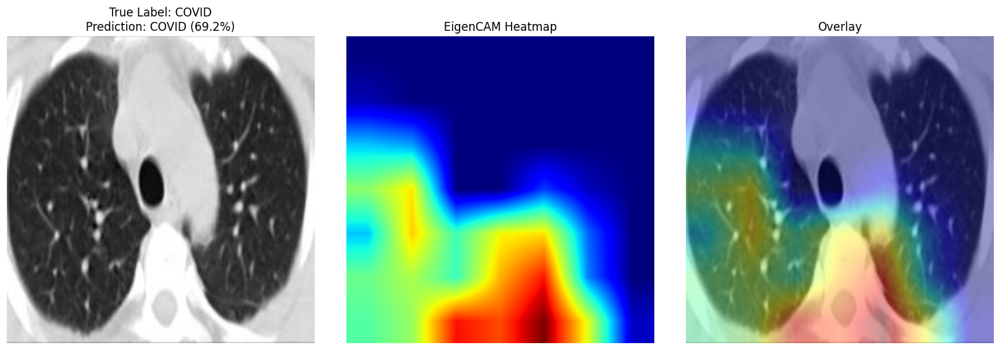


Processing image 2/20: COVID/Covid (957).png


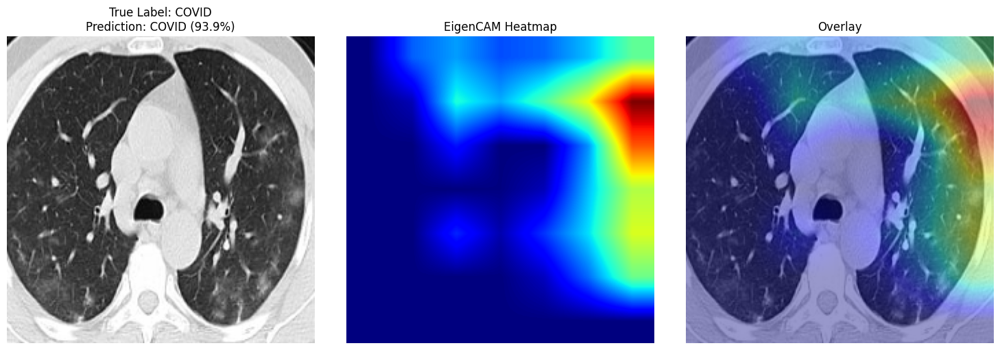


Processing image 3/20: COVID/Covid (388).png


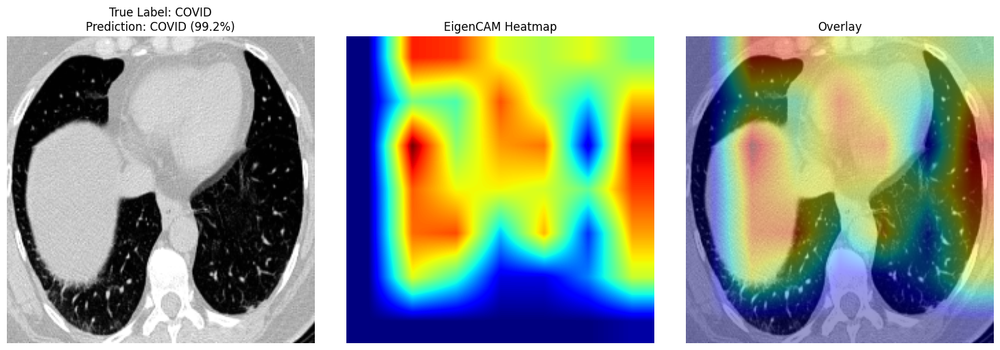


Processing image 4/20: COVID/Covid (524).png


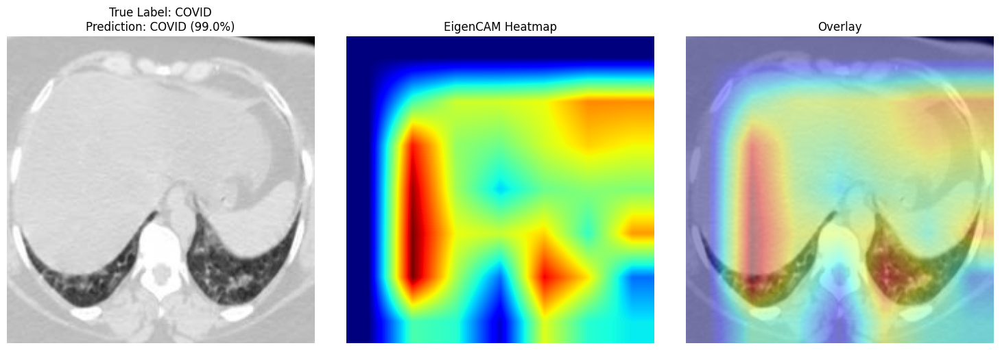


Processing image 5/20: NORMAL/Non-Covid (1132).png


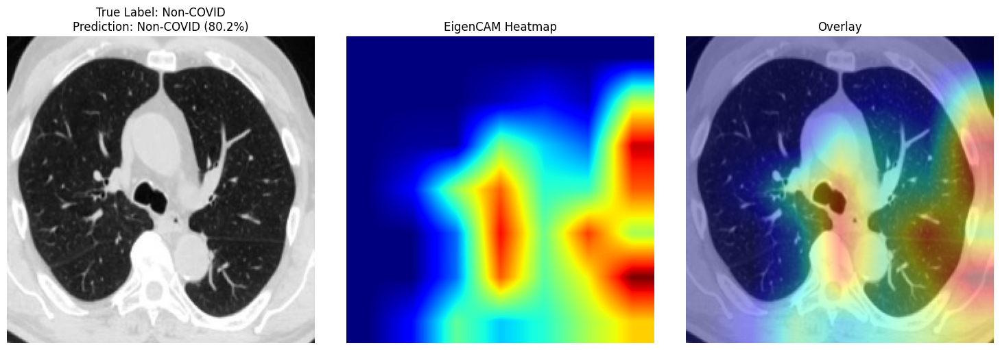


Processing image 6/20: NORMAL/Non-Covid (330).png


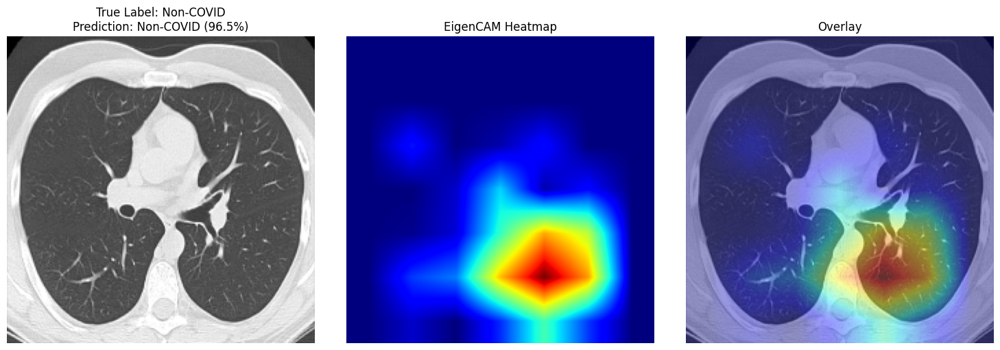


Processing image 7/20: NORMAL/Non-Covid (395).png


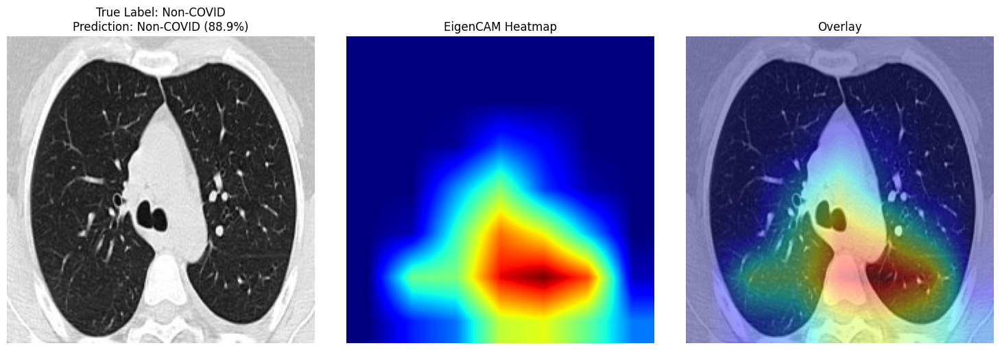


Processing image 8/20: NORMAL/Non-Covid (153).png


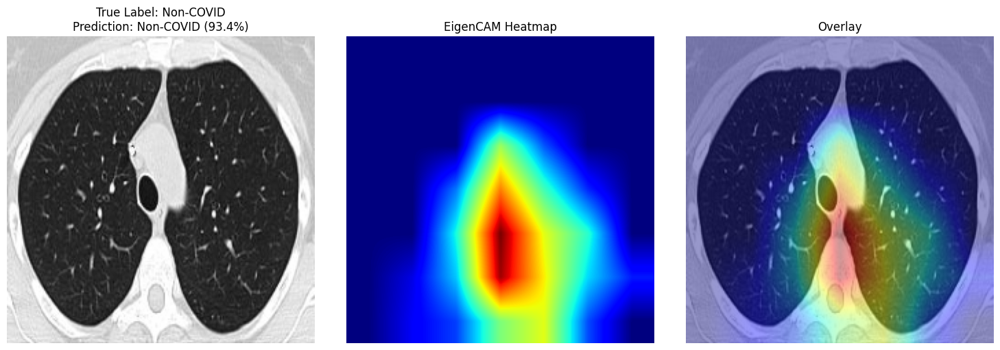


Processing image 9/20: COVID/Covid (944).png


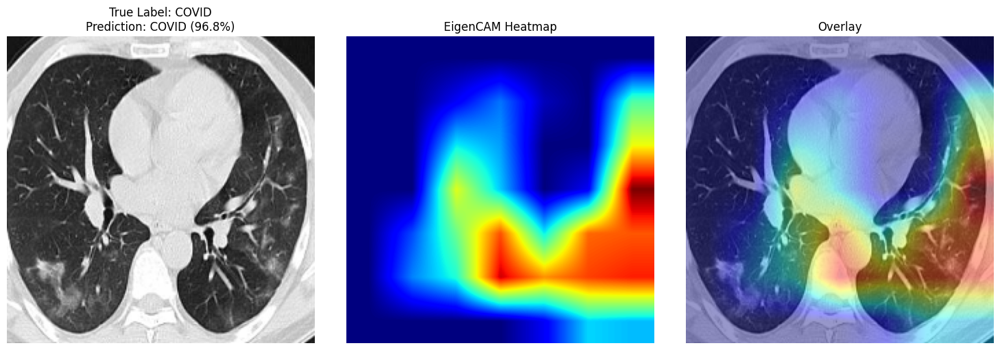


Processing image 10/20: COVID/Covid (579).png


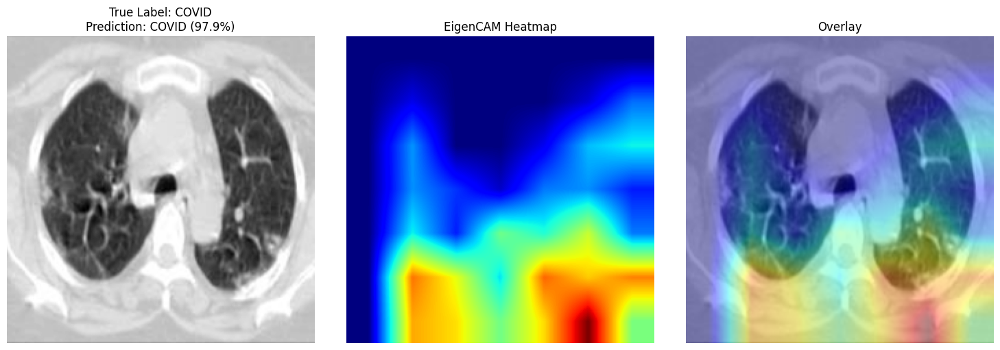


Processing image 11/20: NORMAL/Non-Covid (945).png


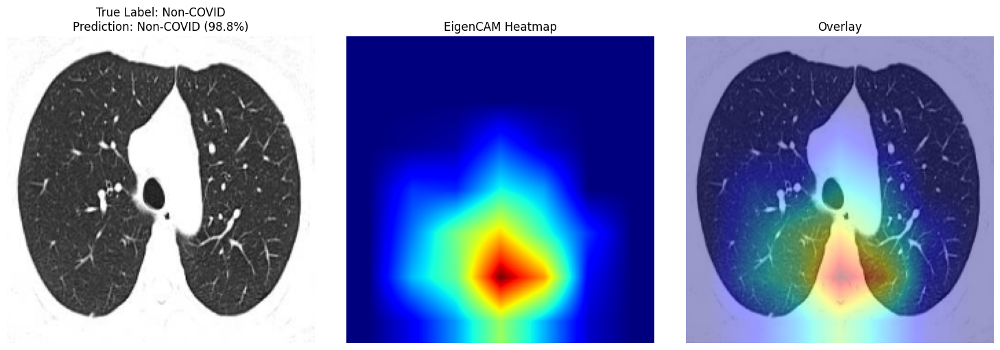


Processing image 12/20: NORMAL/Non-Covid (622).png


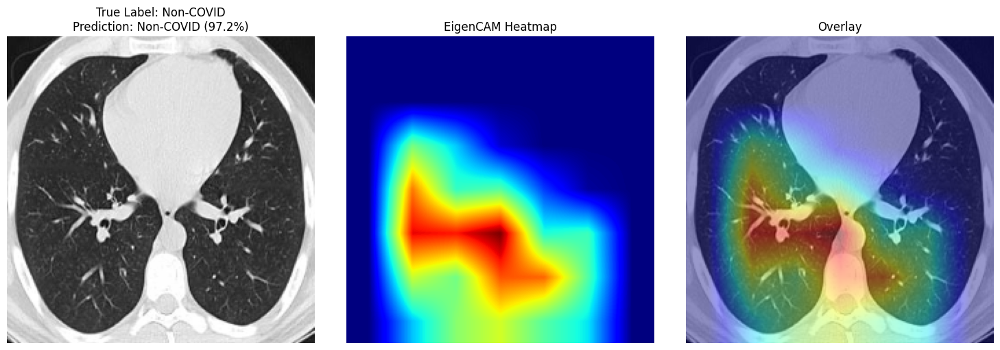


Processing image 13/20: NORMAL/Non-Covid (1148).png


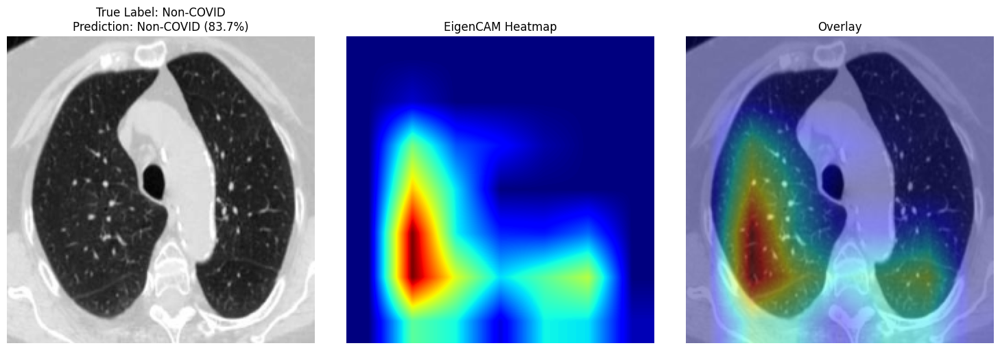


Processing image 14/20: COVID/Covid (672).png


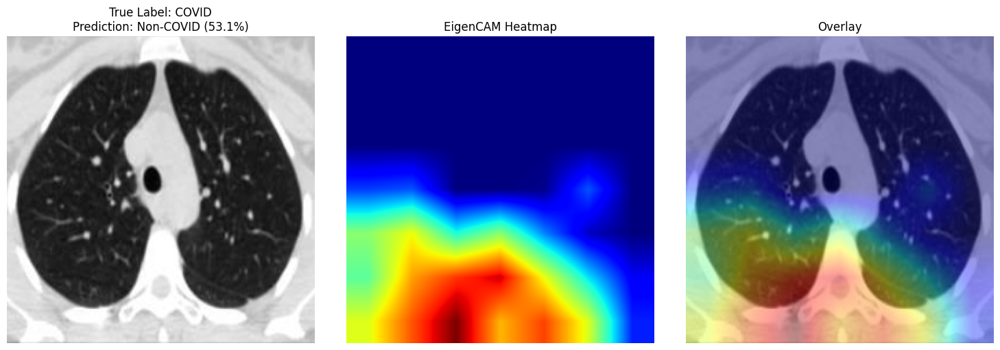


Processing image 15/20: NORMAL/Non-Covid (375).png


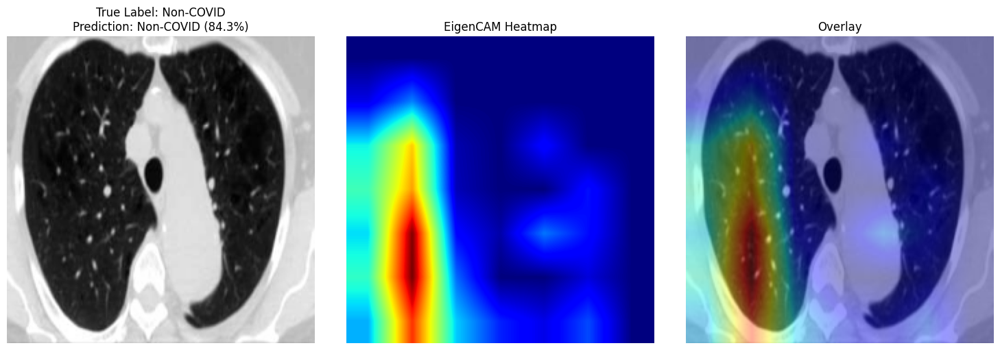


Processing image 16/20: COVID/Covid (649).png


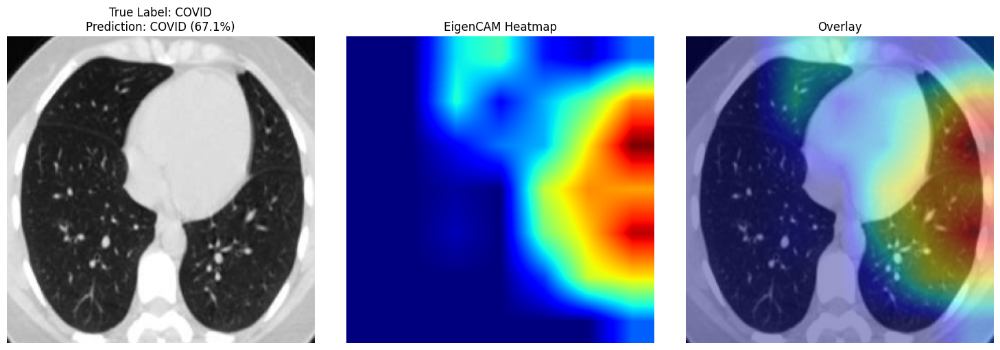


Processing image 17/20: COVID/Covid (36).png


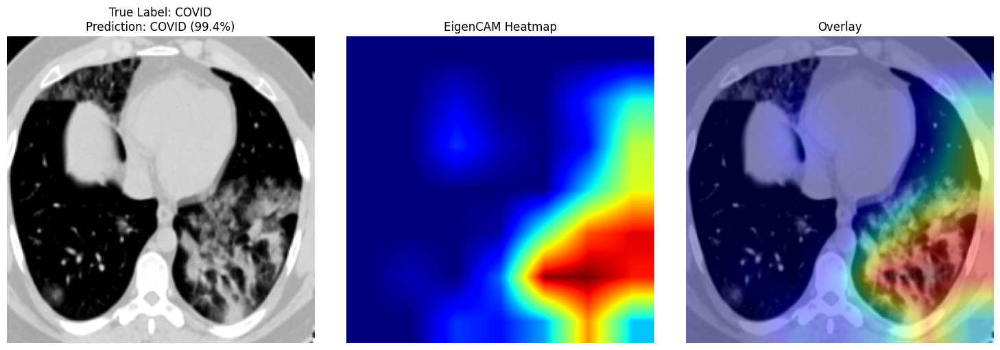


Processing image 18/20: COVID/Covid (32).png


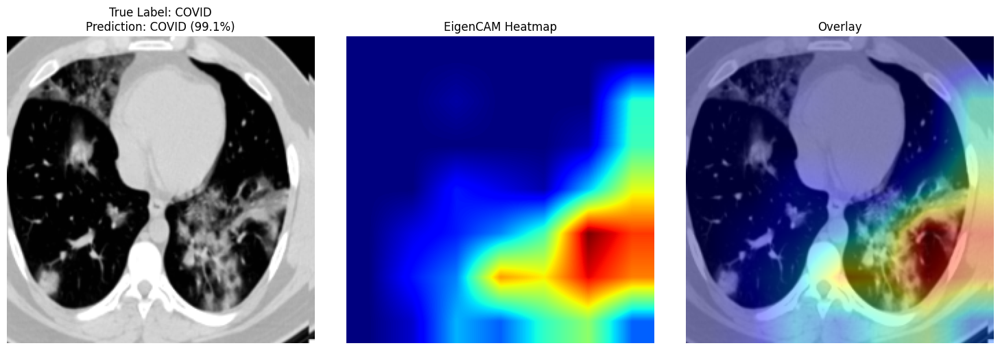


Processing image 19/20: NORMAL/Non-Covid (71).png


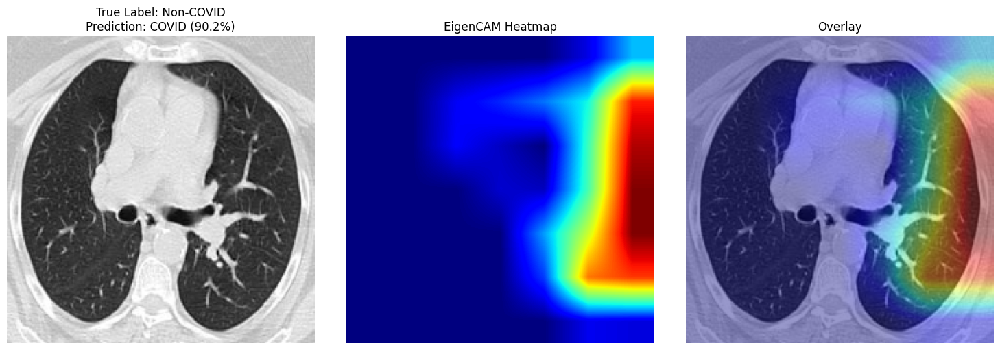


Processing image 20/20: NORMAL/Non-Covid (522).png


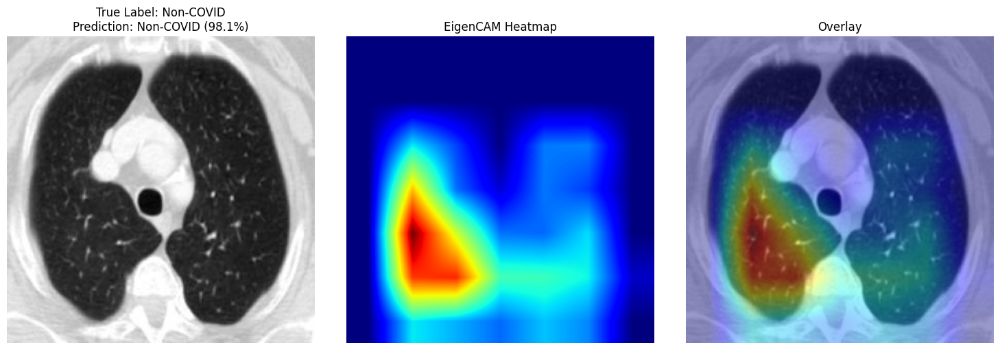


EigenCAM Summary:
Total samples: 20
Correct predictions: 18/20 (90.0%)


In [ ]:
results_scratch = visualize_multiple_eigencam(
    best_model_scratch,
    selected_samples=selected_samples,
    temperature=4.0
)

In [ ]:
analyze_results(results_scratch)


Detailed Analysis:

Class-wise Performance:
Non-COVID:
  Accuracy: 9/10 (90.0%)
  Average Confidence: 91.1%
COVID:
  Accuracy: 9/10 (90.0%)
  Average Confidence: 87.5%

Confidence Analysis:
Average confidence (correct predictions): 91.3%
Average confidence (incorrect predictions): 71.6%


#### Transfer Learning Model


Processing image 1/20: COVID/Covid (1151).png


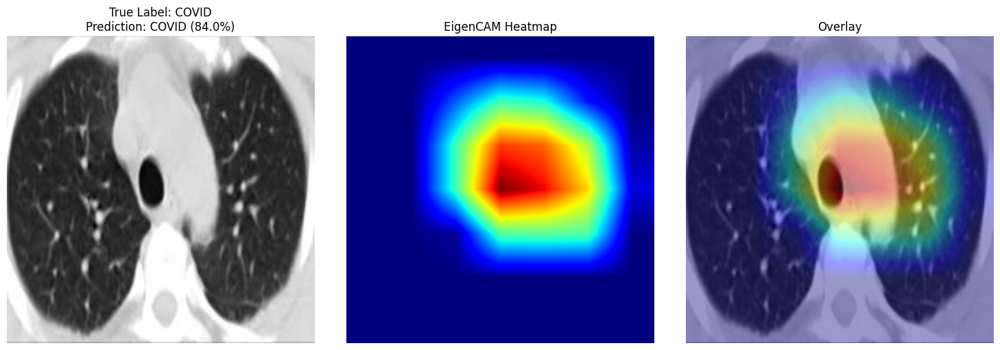


Processing image 2/20: COVID/Covid (957).png


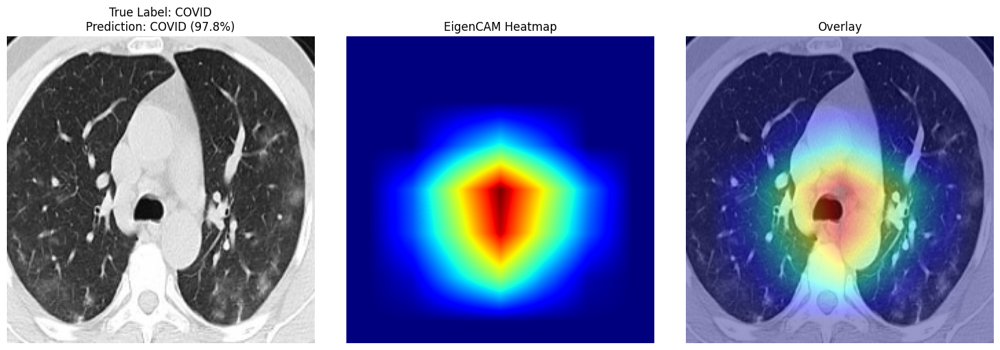


Processing image 3/20: COVID/Covid (388).png


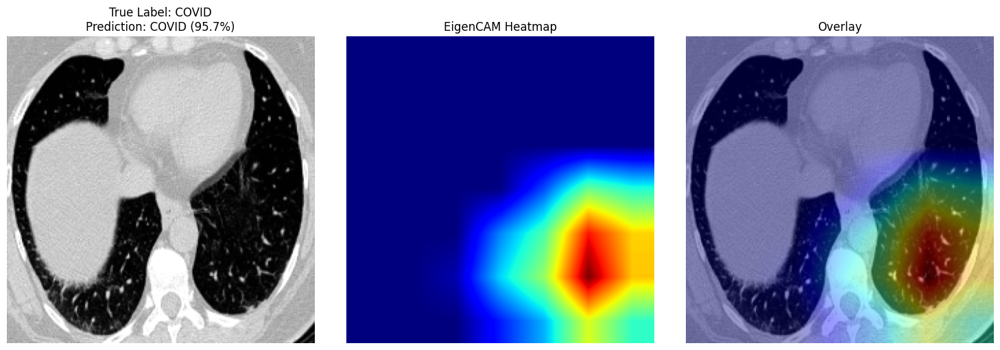


Processing image 4/20: COVID/Covid (524).png


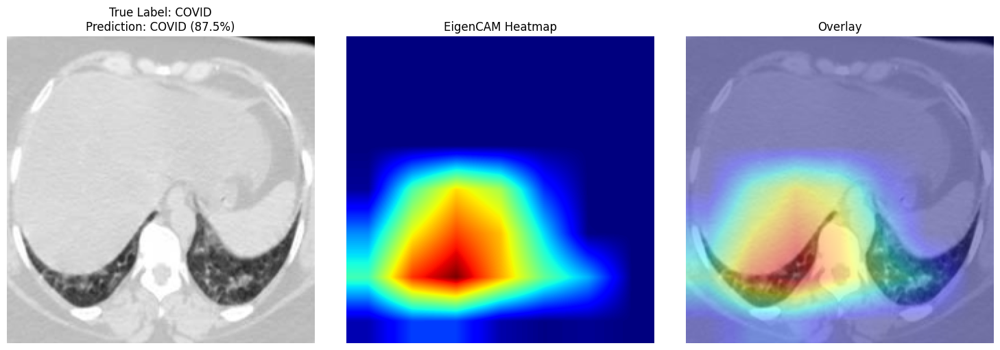


Processing image 5/20: NORMAL/Non-Covid (1132).png


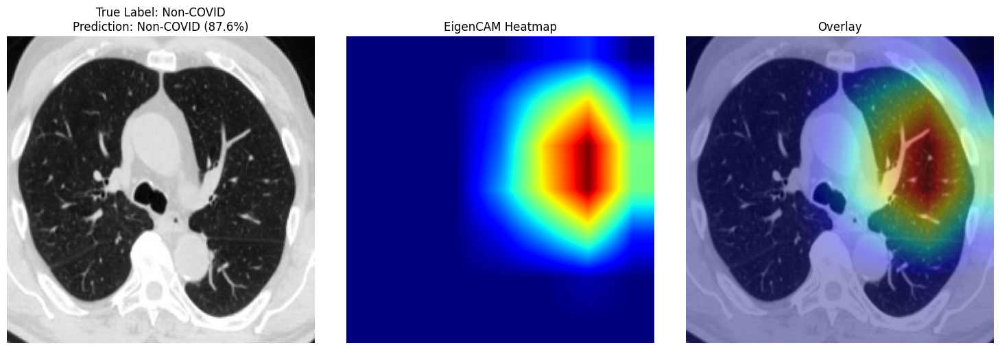


Processing image 6/20: NORMAL/Non-Covid (330).png


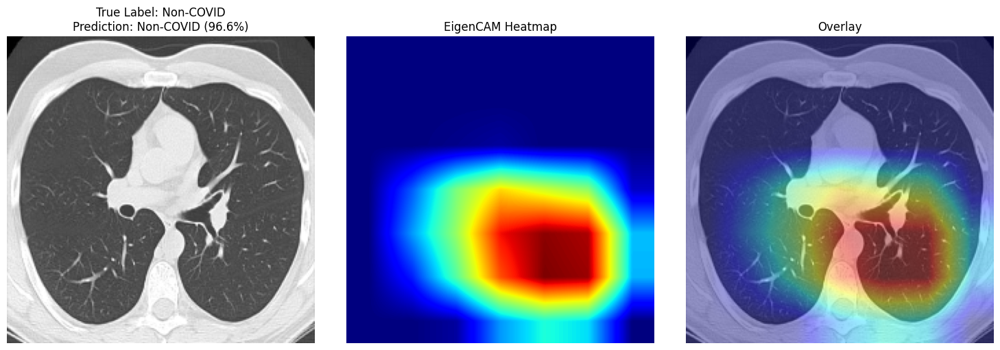


Processing image 7/20: NORMAL/Non-Covid (395).png


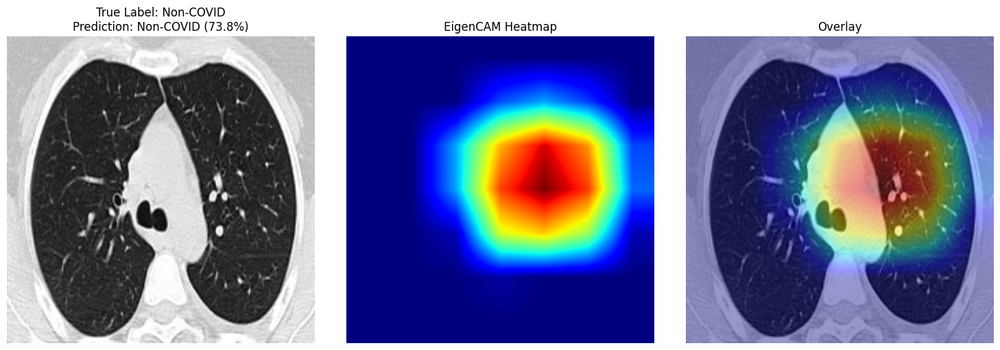


Processing image 8/20: NORMAL/Non-Covid (153).png


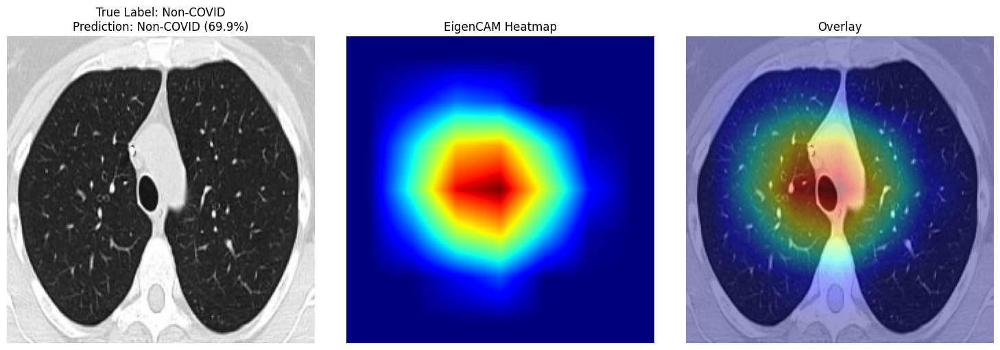


Processing image 9/20: COVID/Covid (944).png


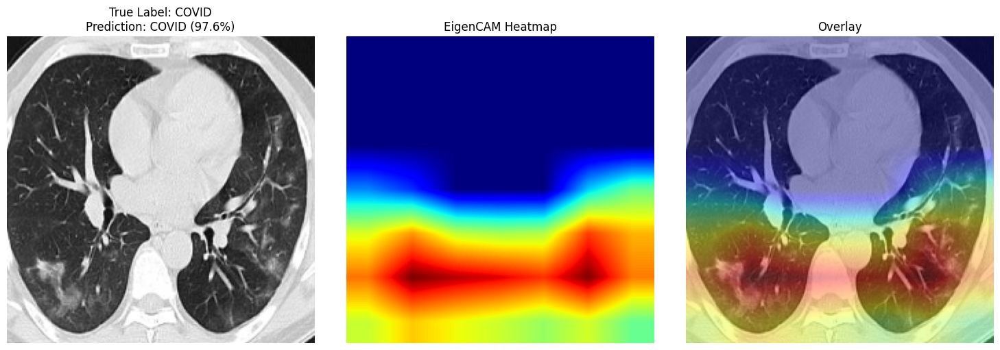


Processing image 10/20: COVID/Covid (579).png


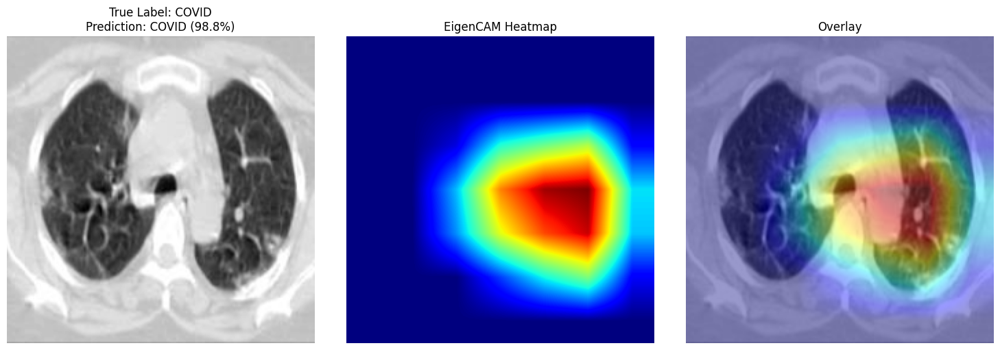


Processing image 11/20: NORMAL/Non-Covid (945).png


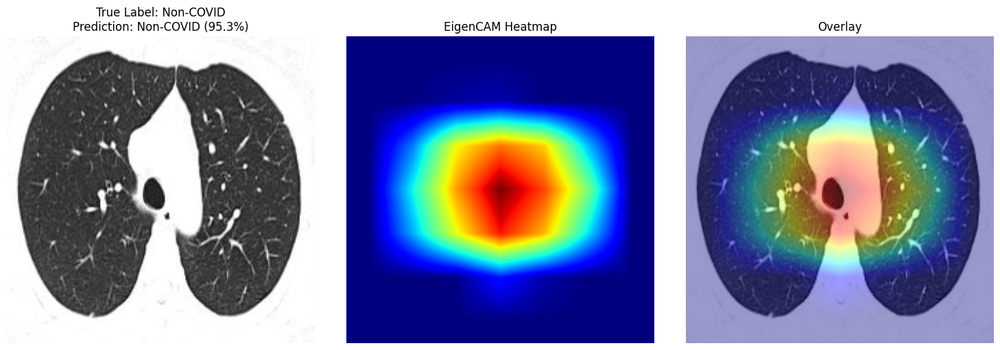


Processing image 12/20: NORMAL/Non-Covid (622).png


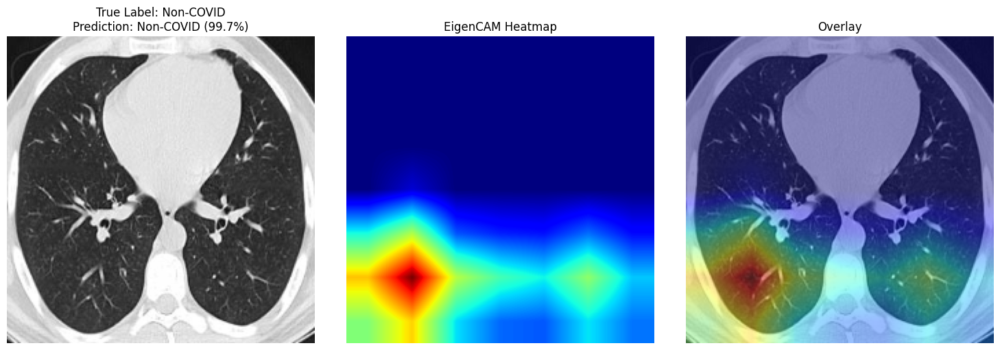


Processing image 13/20: NORMAL/Non-Covid (1148).png


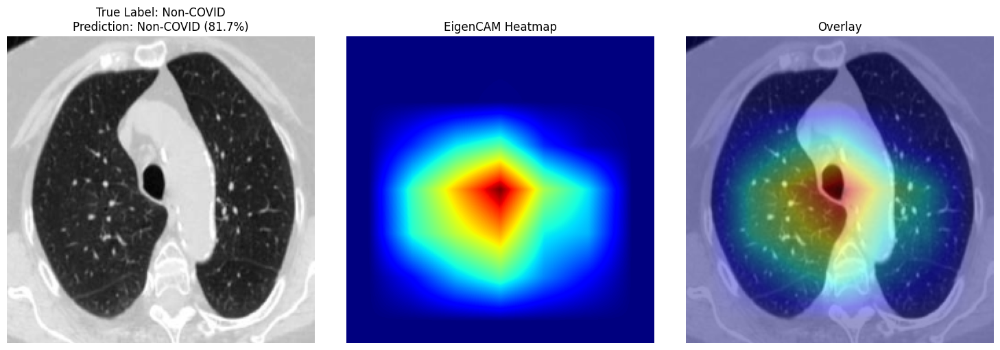


Processing image 14/20: COVID/Covid (672).png


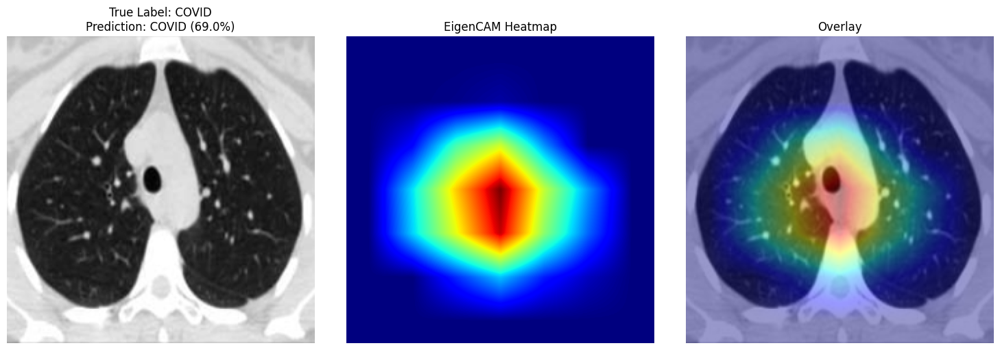


Processing image 15/20: NORMAL/Non-Covid (375).png


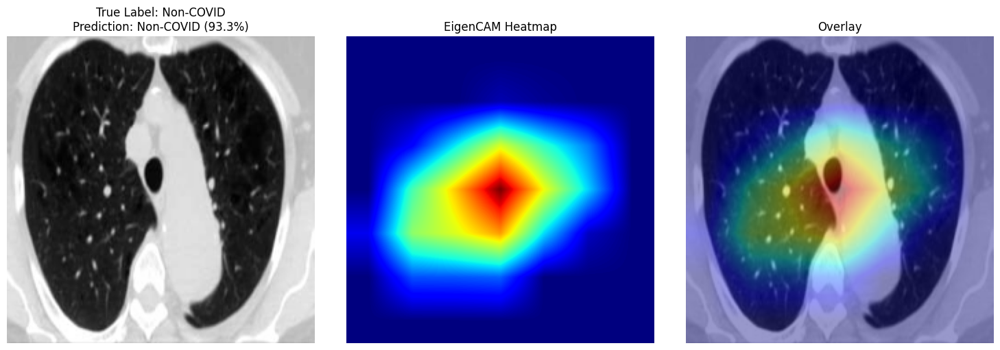


Processing image 16/20: COVID/Covid (649).png


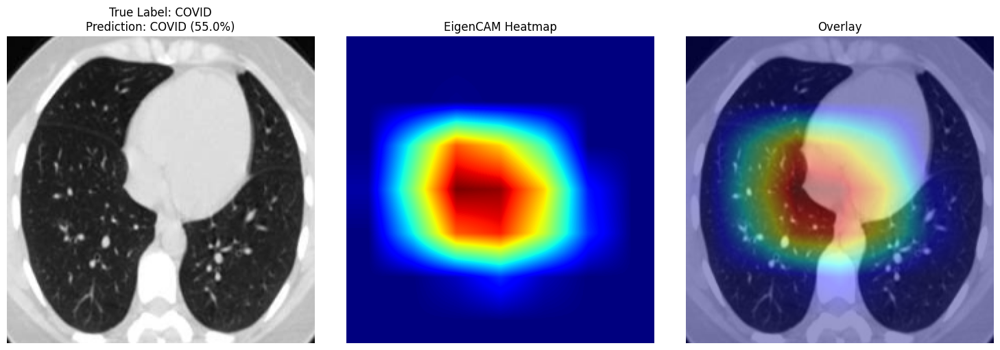


Processing image 17/20: COVID/Covid (36).png


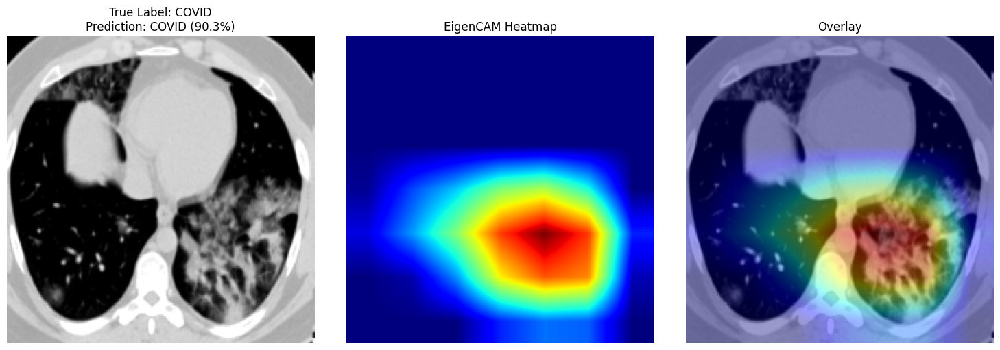


Processing image 18/20: COVID/Covid (32).png


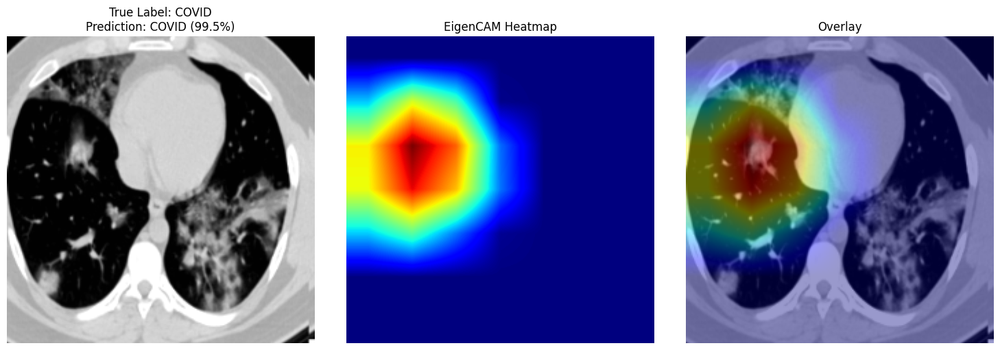


Processing image 19/20: NORMAL/Non-Covid (71).png


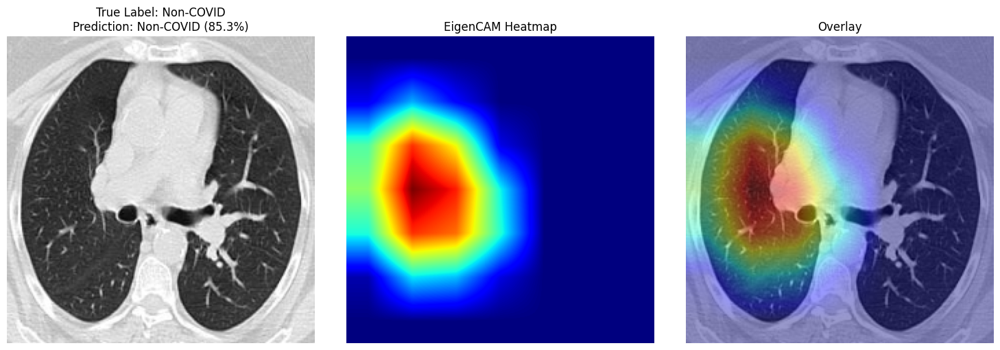


Processing image 20/20: NORMAL/Non-Covid (522).png


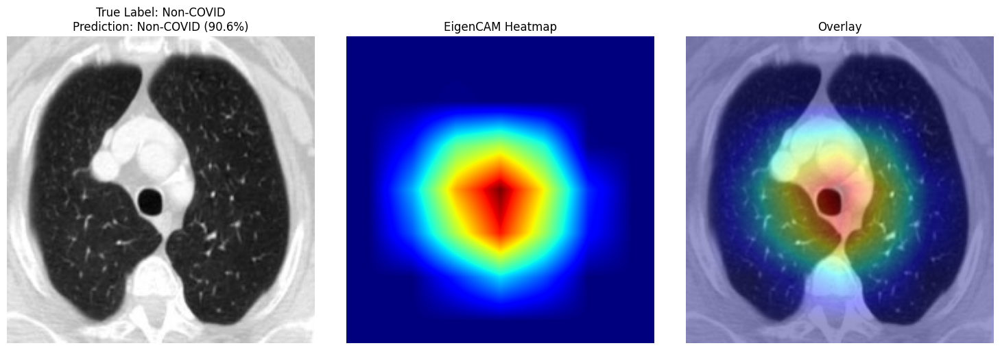


EigenCAM Summary:
Total samples: 20
Correct predictions: 20/20 (100.0%)


In [ ]:
results_transfer = visualize_multiple_eigencam(
    best_model_transfer,
    selected_samples=selected_samples,
    temperature=4.0
)

In [ ]:
analyze_results(results_transfer)


Detailed Analysis:

Class-wise Performance:
Non-COVID:
  Accuracy: 10/10 (100.0%)
  Average Confidence: 87.4%
COVID:
  Accuracy: 10/10 (100.0%)
  Average Confidence: 87.5%

Confidence Analysis:
Average confidence (correct predictions): 87.5%
Average confidence (incorrect predictions): nan%


## Conclusion

The comparative analysis demonstrates that transfer learning offers significant advantages over training from scratch for COVID-19 CT image classification. Despite the domain difference between natural images (ImageNet) and medical CT scans, the pre-trained weights provided valuable feature extraction capabilities that transferred effectively to this medical imaging task.

The success of this approach suggests that transfer learning should be considered as a primary strategy when developing similar medical imaging applications, particularly when working with limited datasets or when rapid deployment is necessary.

Next Steps to consider would be trying to incorporate more domain-specific medical pretraining, or Exploring the impact of different pre-training data sets.